# **Part I: Define an RL Environment**

In [1]:
!pip install gymnasium


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 5.8 MB/s eta 0:00:00


In [2]:
!pip install gym


In [4]:
!pip install optuna


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.6/409.6 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 230.6/230.6 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.9 MB/s eta 0:00:00


In [5]:
#load required libraries
import gymnasium as gym
from gymnasium import spaces
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import optuna
import cv2

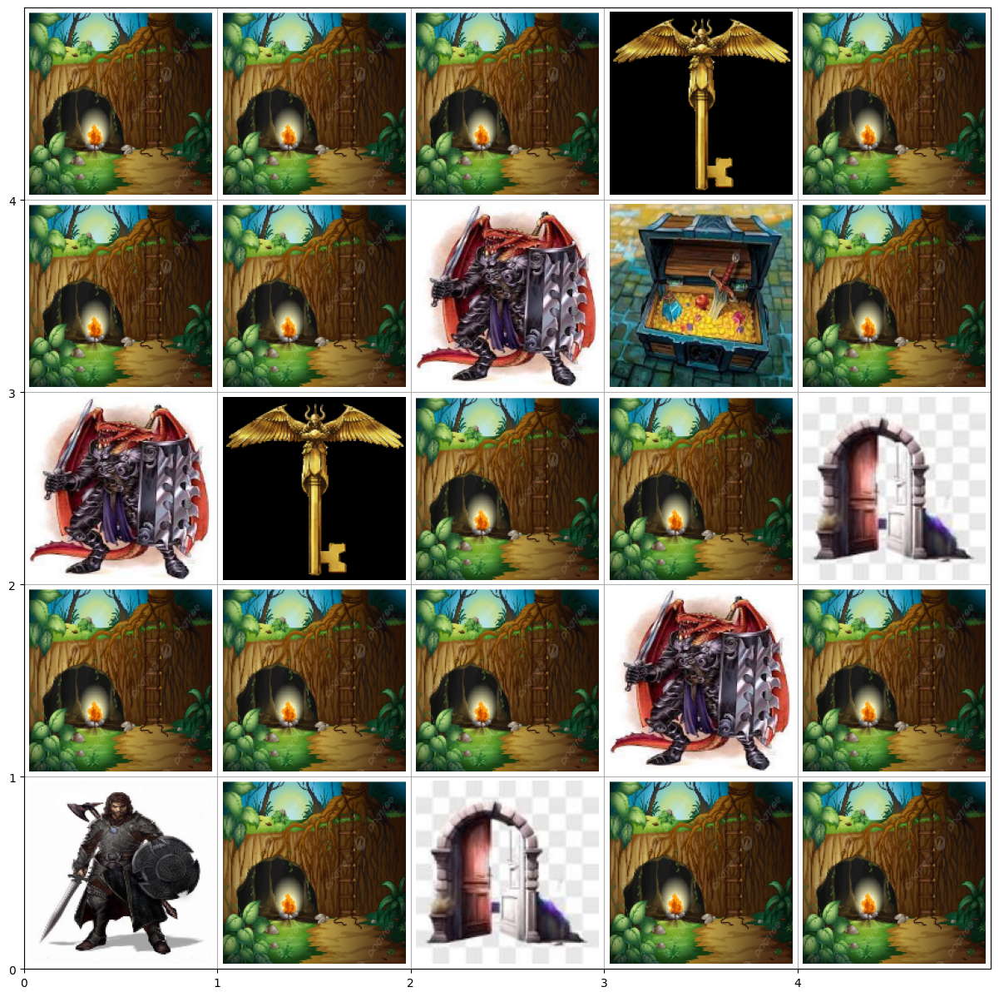

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [8]:
# Drgon and dungeon grid for RL environment
class DungeonEnvironment(gym.Env):
    # Attribute of a Gym class that provides info about the render modes
    metadata = {'render.modes': []}

    # Initialization function
    def __init__(self):
        self.grid_size = 5
        self.observation_space = spaces.Discrete(self.grid_size * self.grid_size)
        self.action_space = spaces.Discrete(4)

        self.state = np.asarray([0, 0])
        self.treasure_positions = np.asarray([3, 3])
        self.enemy_positions = np.asarray([[1, 3], [2, 0], [3, 2]])
        self.door_positions = np.asarray([[0, 2], [2, 4]])
        self.key_positions = np.asarray([[2, 1], [4, 3]])


        self.treasure_notfound = True
        self.max_reward = 10
        self.min_reward = -10
        #we are storing the collected keys
        self.collected_keys = set()


    # Step function

    def step(self, action):
        if action == 0:  #up
            next_state = (min(self.grid_size - 1, self.state[0] + 1), self.state[1])
        elif action == 1:  #down
            next_state = (max(0, self.state[0] - 1), self.state[1])
        elif action == 2:  #right
            next_state = (self.state[0], min(self.grid_size - 1, self.state[1] + 1))
        elif action == 3:  #left
            next_state = (self.state[0], max(0, self.state[1] - 1))

        reward = 0

        #collision check
        if any(np.array_equal(next_state, enemy) for enemy in self.enemy_positions):
            reward = -10

        #treasure check
        if any(np.array_equal(next_state, treasure) for treasure in self.treasure_positions):
            reward = 10

        #key and door check
        if any(np.array_equal(next_state, door) for door in self.door_positions):
            if any(tuple(key) in map(tuple, self.collected_keys) for key in self.key_positions):
                reward = 5  #+ve reward for opening a door with a key
            else:
                reward = -5

        if any(np.array_equal(next_state, key) for key in self.key_positions):
            self.collected_keys.add(next_state)
        state_c = self.state
        self.state = next_state

        # punishing same state action and rewarding moving forward
        if(np.array_equal(state_c, next_state)):
            reward = -2
        elif(reward == 0):
            reward = 1

        done = False
        if next_state == (self.grid_size - 1, self.grid_size - 1):
            done = True

        return self.state[0]*self.grid_size+self.state[1], state_c[0]*self.grid_size+state_c[1], reward, done, {}

    def reset(self):
        self.state = (0, 0)
        self.collected_keys.clear()
        return self.observation_space.sample()

    # Render function
    def render(self, mode='human', plot=False):
        image_folder = '/tmp/Images_d&d/images_d&d'

        fig, ax = plt.subplots(figsize=(15, 15))
        ax.set_xlim(0, self.grid_size)
        ax.set_ylim(0, self.grid_size)

        def plot_image(plot_pos):
            # ploting part idea is taken from wumpus_world.py - credits:Prof.Alina Vereshka
            image_folder = '/tmp/Images_d&d/images_d&d'
            image_path = f'{image_folder}/path.png'

            plot_player, plot_empty, plot_treasure, plot_path, plot_enemy, plot_opendoor,plot_closeddoor,plot_key,plot_fighter_enemy,plot_fighter_key,plot_fighter_treasure = \
                False, False, False, False, False, False, False, False,False,False,False

            # Checking which objects need to be plotted by comparing their positions.
            #plot for player
            if np.array_equal(self.state, plot_pos):
                plot_player = True
                image_path = f'{image_folder}/Fighter.png'

             #plot for enemy
            if any(np.array_equal(self.enemy_positions[i], plot_pos) for i in range(len(self.enemy_positions))):
                plot_enemy = True
                image_path =f'{image_folder}/dragon.png'

            #plot for treasure
            if self.treasure_notfound:
                if np.array_equal(plot_pos, self.treasure_positions):
                    plot_treasure = True
                    image_path = f'{image_folder}/treasure.png'

             #plot for key
            if any(np.array_equal(self.key_positions[i], plot_pos) for i in range(len(self.key_positions))):
                plot_key = True
                image_path = f'{image_folder}/key_to_door.png'

            #plot for opendoor
            if any(np.array_equal(self.door_positions[i], plot_pos) for i in range(len(self.door_positions))):
                    plot_opendoor = True
                    image_path = f'{image_folder}/opendoor.png'


            if any(np.array_equal(self.state, enemy_pos) for enemy_pos in self.enemy_positions):
                if np.array_equal(self.state, plot_pos):
                    print("Player overlaps with an enemy!")
                    image_path = f'{image_folder}/knight_dragon.png'

            if any(np.array_equal(self.state, key_pos) for key_pos in self.key_positions):
                if np.array_equal(self.state, plot_pos):
                    print("Player overlaps with a key!")
                    image_path = f'{image_folder}/knight_key.png'

            if np.array_equal(self.state, self.treasure_positions):
                if np.array_equal(self.state, plot_pos):
                    print("Player overlaps with a treasure!")
                    image_path = f'{image_folder}/fighter_gold12.png'



            if(not any([plot_player, plot_treasure, plot_path, plot_enemy, plot_opendoor,plot_closeddoor,plot_key,plot_fighter_enemy,plot_fighter_key,plot_fighter_treasure])):
                plot_empty = True

            img = cv2.imread(image_path)
            img = cv2.resize(img, (158, 158))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            image = AnnotationBbox(OffsetImage(img, zoom=1),
                                   (plot_pos[1] + 0.5, plot_pos[0] + 0.5), frameon=False)
            ax.add_artist(image)

        element_images = {
            0: f'{image_folder}/path.png',
            1: f'{image_folder}/Fighter.png',
            2: f'{image_folder}/treasure.png',
            -1: f'{image_folder}/dragon.png',
            3: f'{image_folder}/opendoor.png',
            4: f'{image_folder}/key_to_door.png'
        }

        for row in range(self.grid_size):
            for col in range(self.grid_size):
                position = (row, col)
                plot_image(position)

        plt.xticks(np.arange(0, self.grid_size, 1))
        plt.yticks(np.arange(0, self.grid_size, 1))
        plt.grid()

        if plot:
            plt.show()
        else:
            fig.canvas.draw()
            img = np.array(fig.canvas.renderer.buffer_rgba())[:, :, :3]
            width, height = 84, 84
            dim = (width, height)
            preprocessed_image = cv2.resize(img, dim, interpolation=cv2.INTER_AREA)
            plt.show()
            return preprocessed_image

env =  DungeonEnvironment()
obs = env.reset()
env.render()


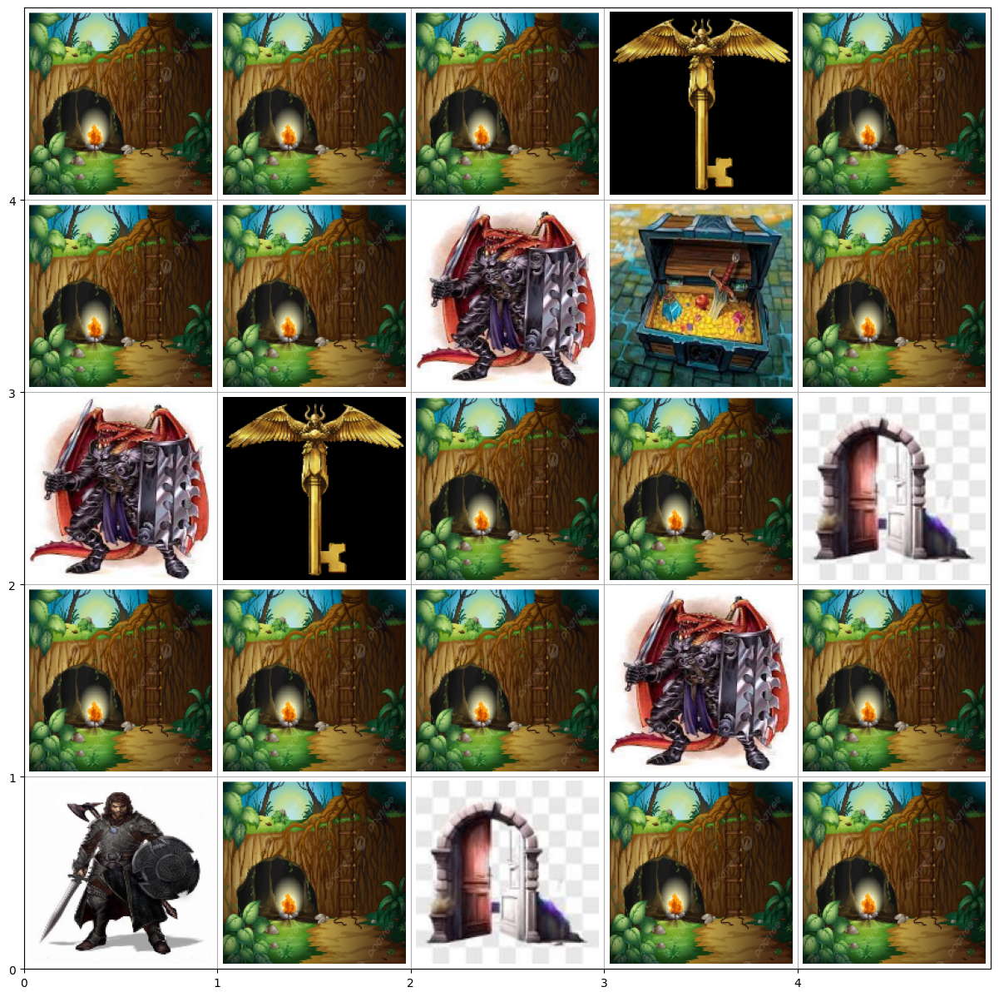

Next State: 1, Current State:0, Action: 2, Reward: 1
Next State: 6, Current State:1, Action: 0, Reward: 1
Next State: 5, Current State:6, Action: 3, Reward: 1
Next State: 6, Current State:5, Action: 2, Reward: 1
Next State: 5, Current State:6, Action: 3, Reward: 1
Next State: 6, Current State:5, Action: 2, Reward: 1
Next State: 5, Current State:6, Action: 3, Reward: 1
Next State: 10, Current State:5, Action: 0, Reward: -10
Next State: 15, Current State:10, Action: 0, Reward: 1
Next State: 20, Current State:15, Action: 0, Reward: 1
Next State: 20, Current State:20, Action: 0, Reward: -2
Next State: 21, Current State:20, Action: 2, Reward: 1


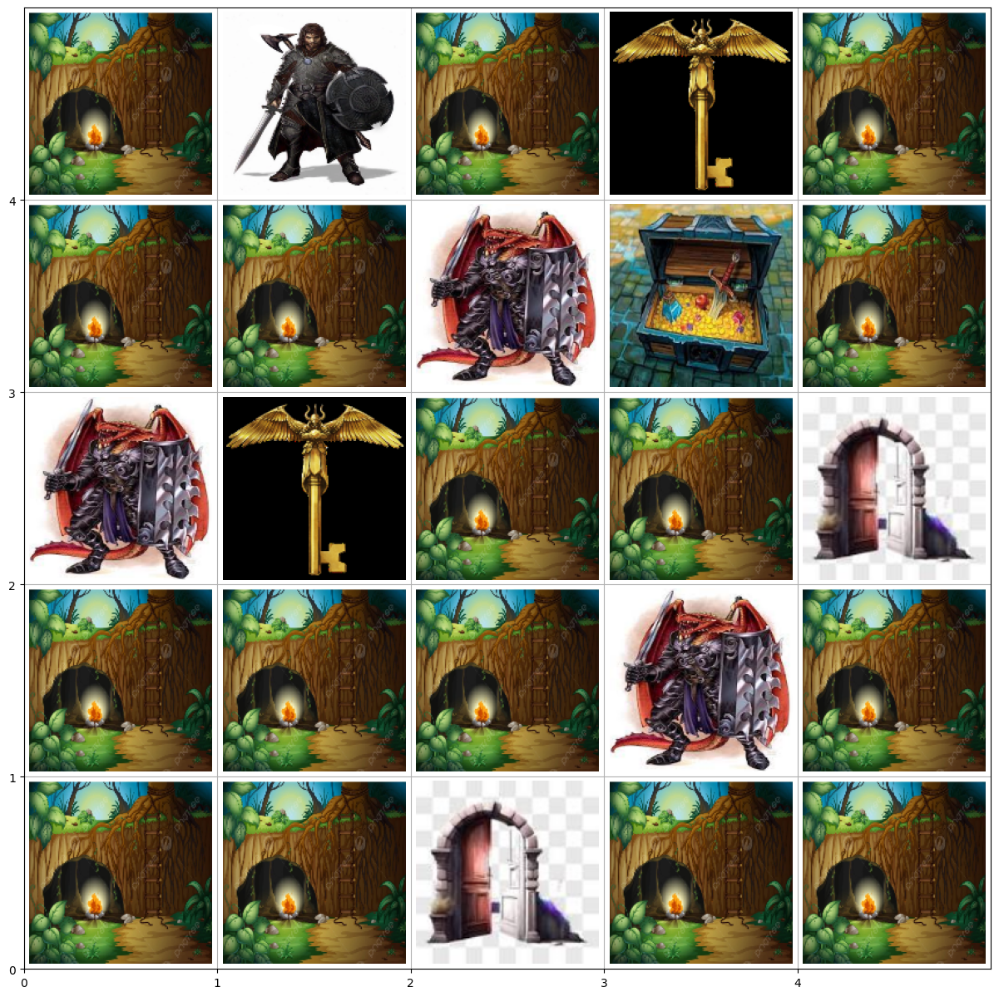

In [9]:
#perform 12 sequence of actions within the environment.

env = DungeonEnvironment()
env.render(plot=True)
for _ in range(12):
    action = env.action_space.sample()
    next_state, current_state, reward, done, _= env.step(action)

    print(f"Next State: {next_state}, Current State:{current_state}, Action: {action}, Reward: {reward}")

env.render(plot=True)

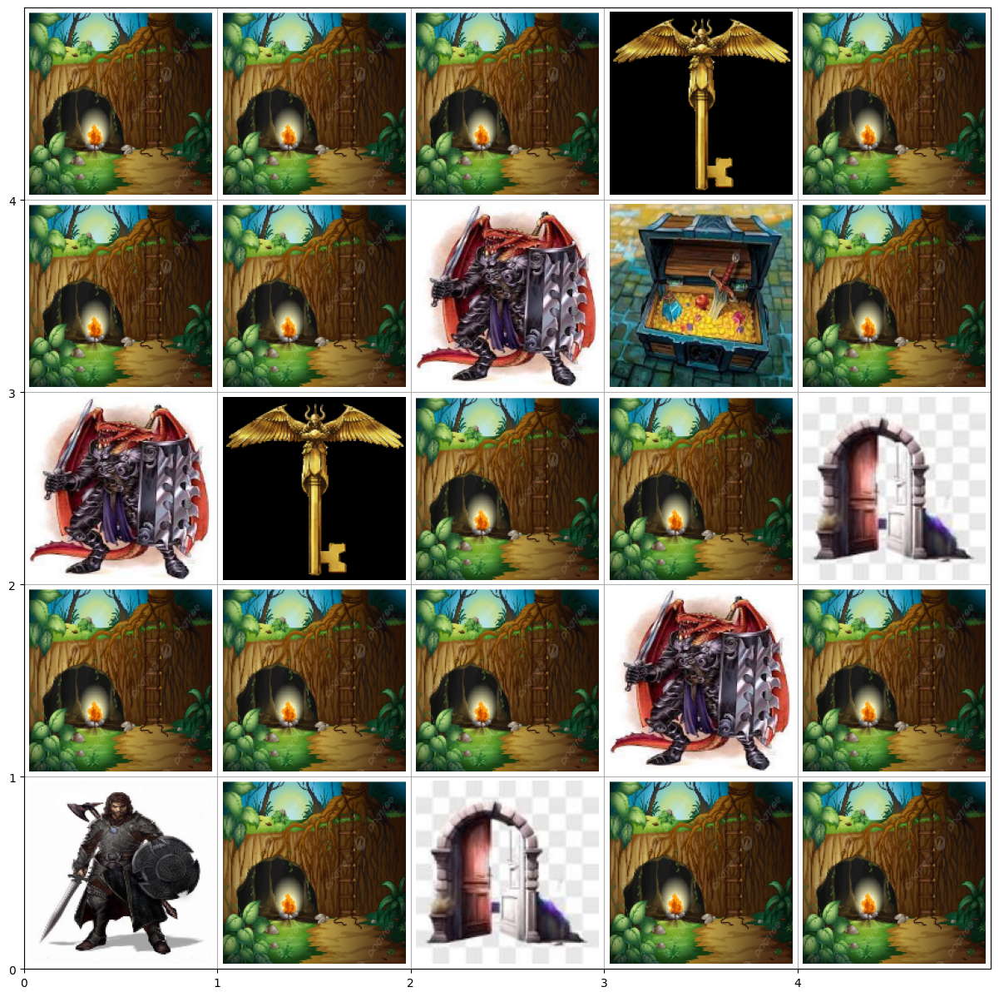

Next State: 0, Current State:0, Action: 1, Reward: -2


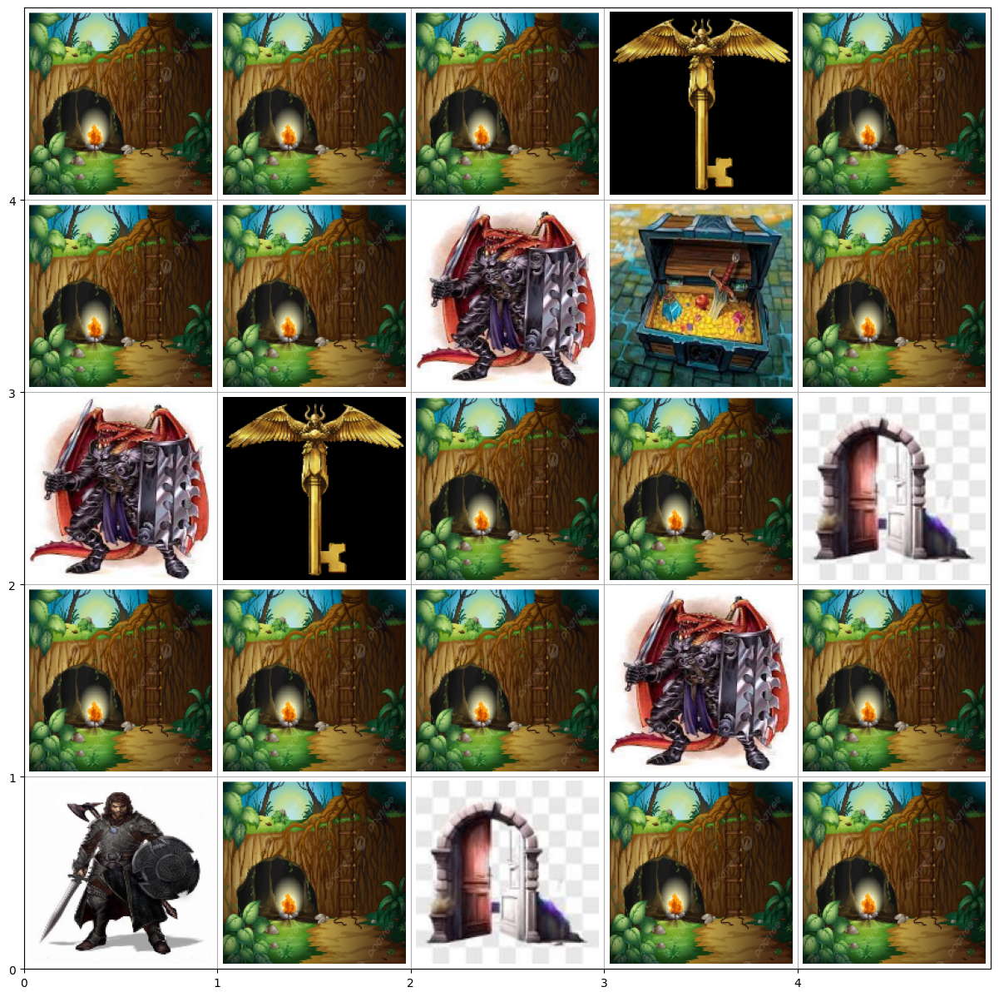

Next State: 0, Current State:0, Action: 3, Reward: -2


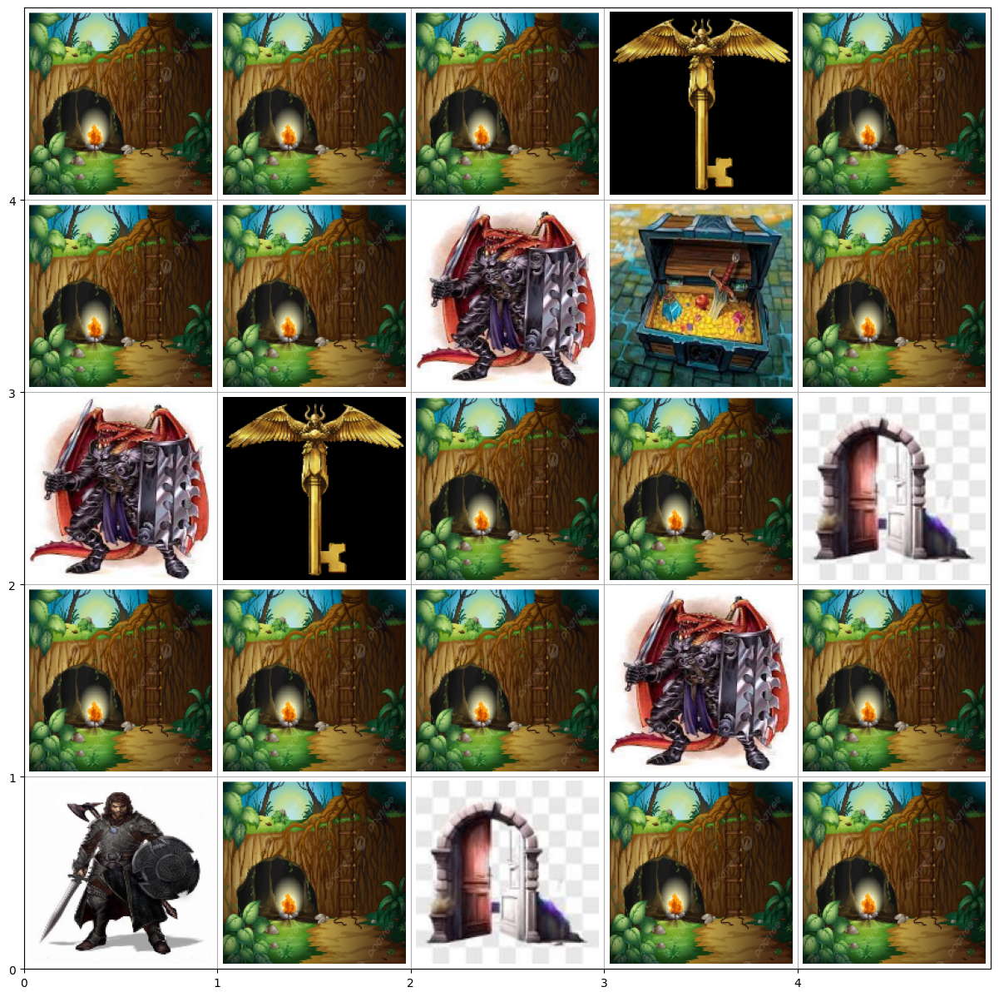

Next State: 5, Current State:0, Action: 0, Reward: 1


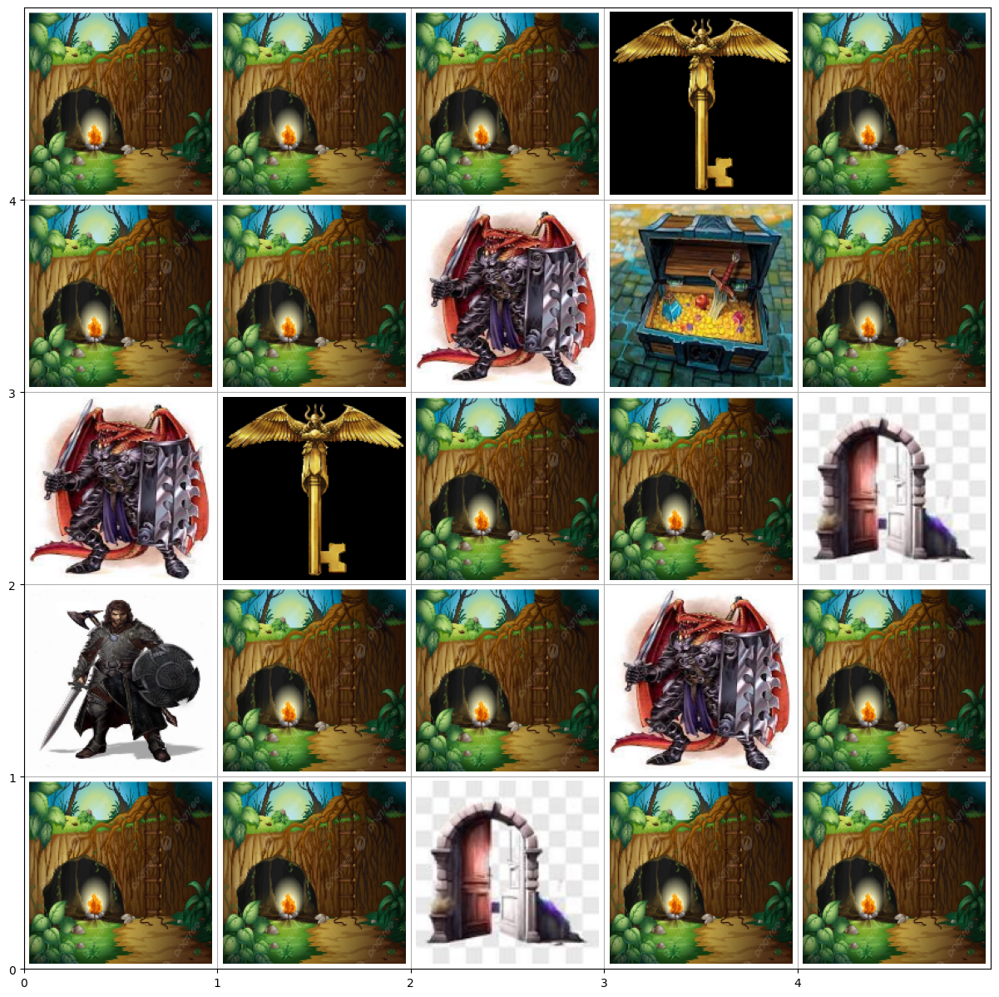

Next State: 6, Current State:5, Action: 2, Reward: 1


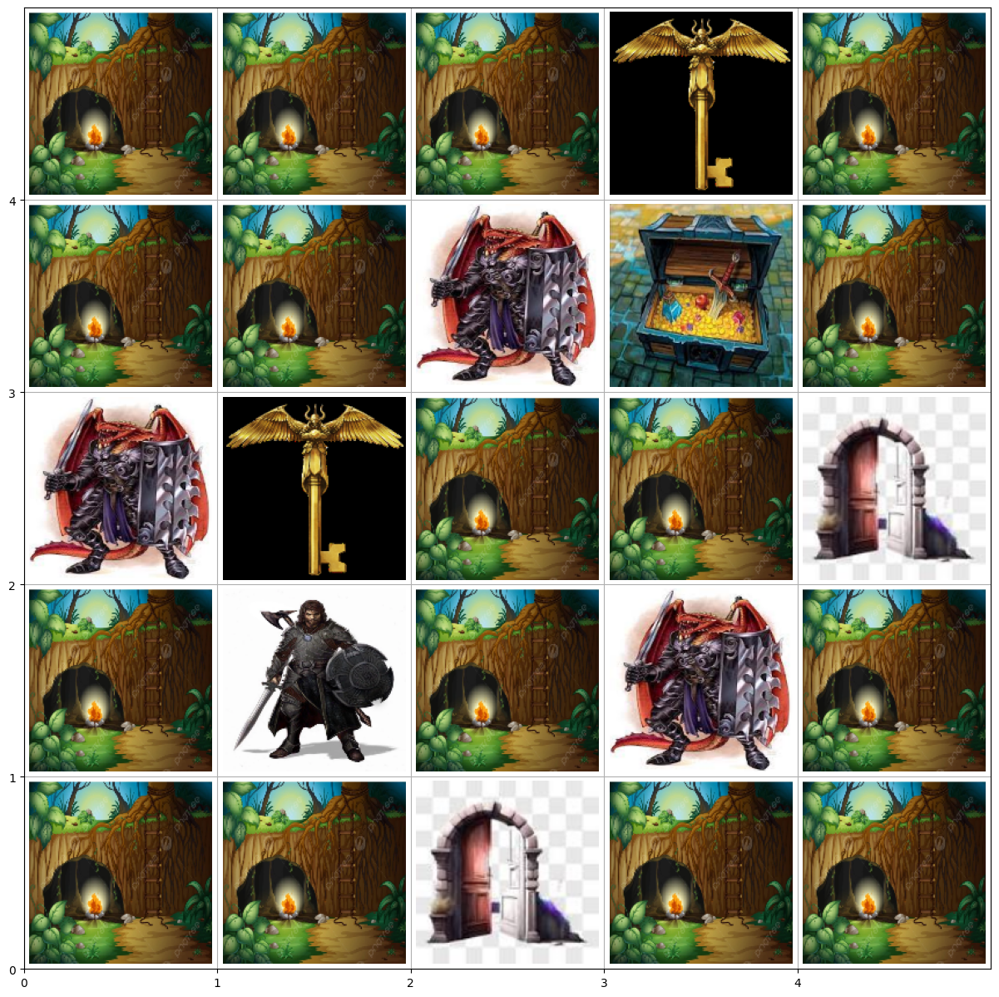

Next State: 7, Current State:6, Action: 2, Reward: 1


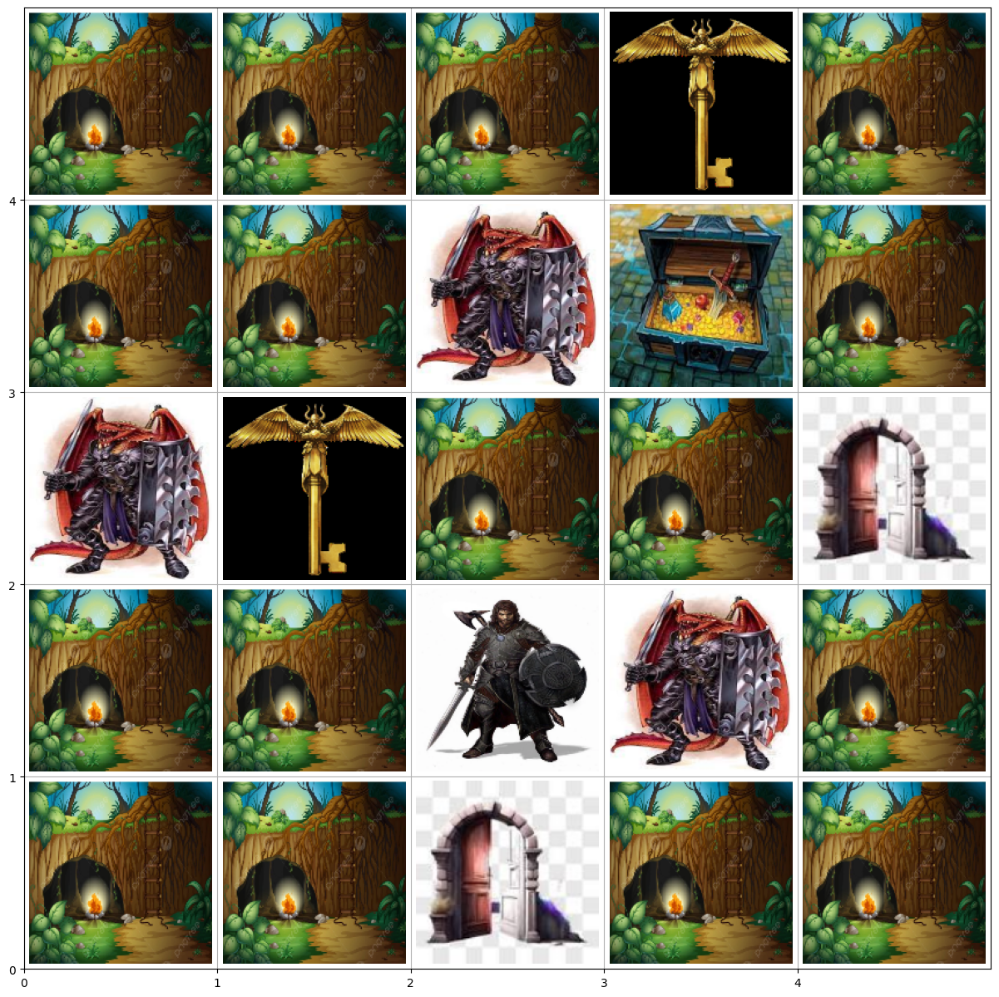

Next State: 6, Current State:7, Action: 3, Reward: 1


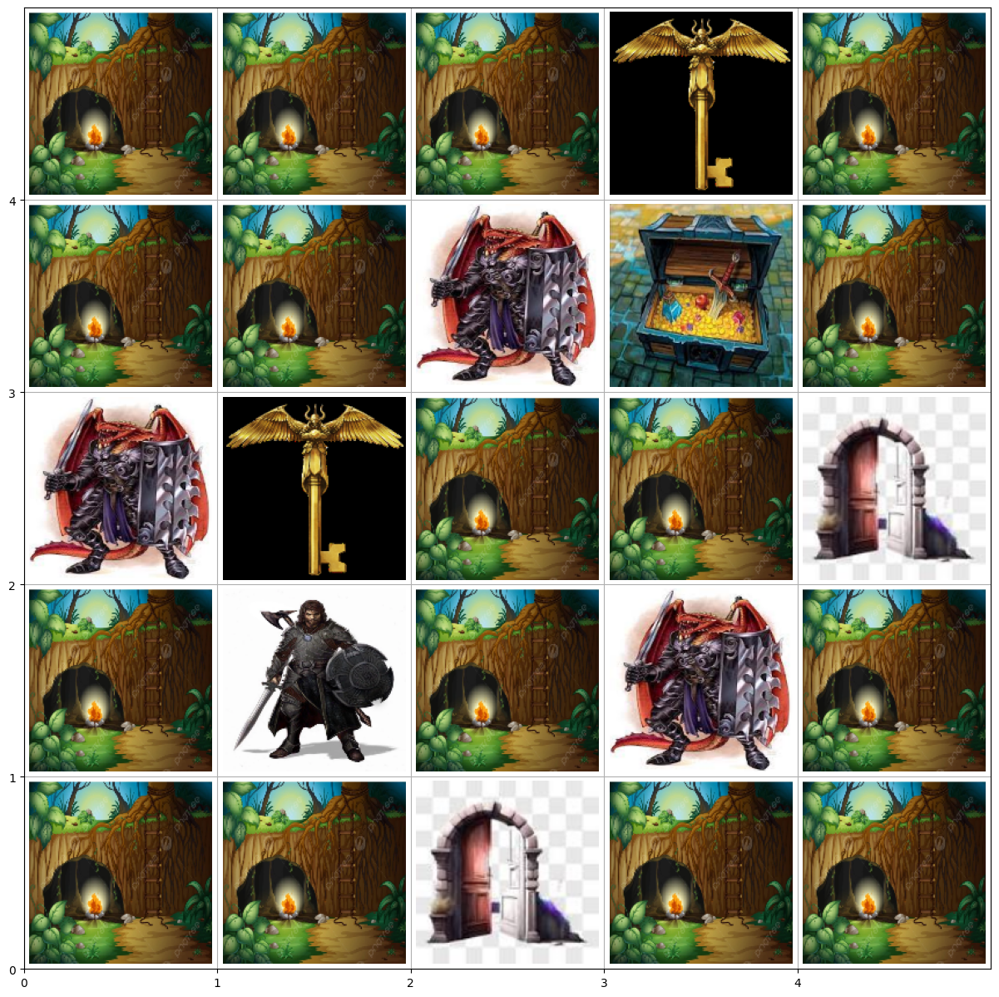

Next State: 11, Current State:6, Action: 0, Reward: 1
Player overlaps with a key!


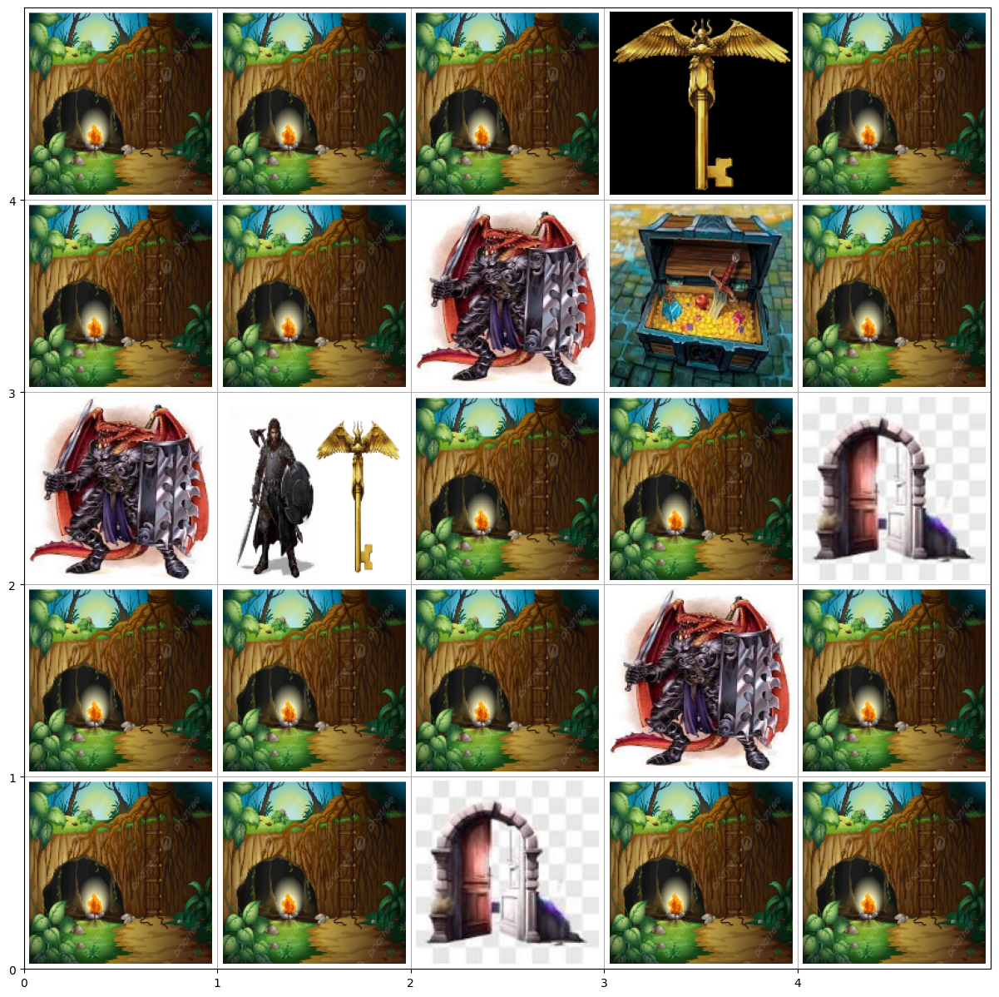

Next State: 10, Current State:11, Action: 3, Reward: -10
Player overlaps with an enemy!


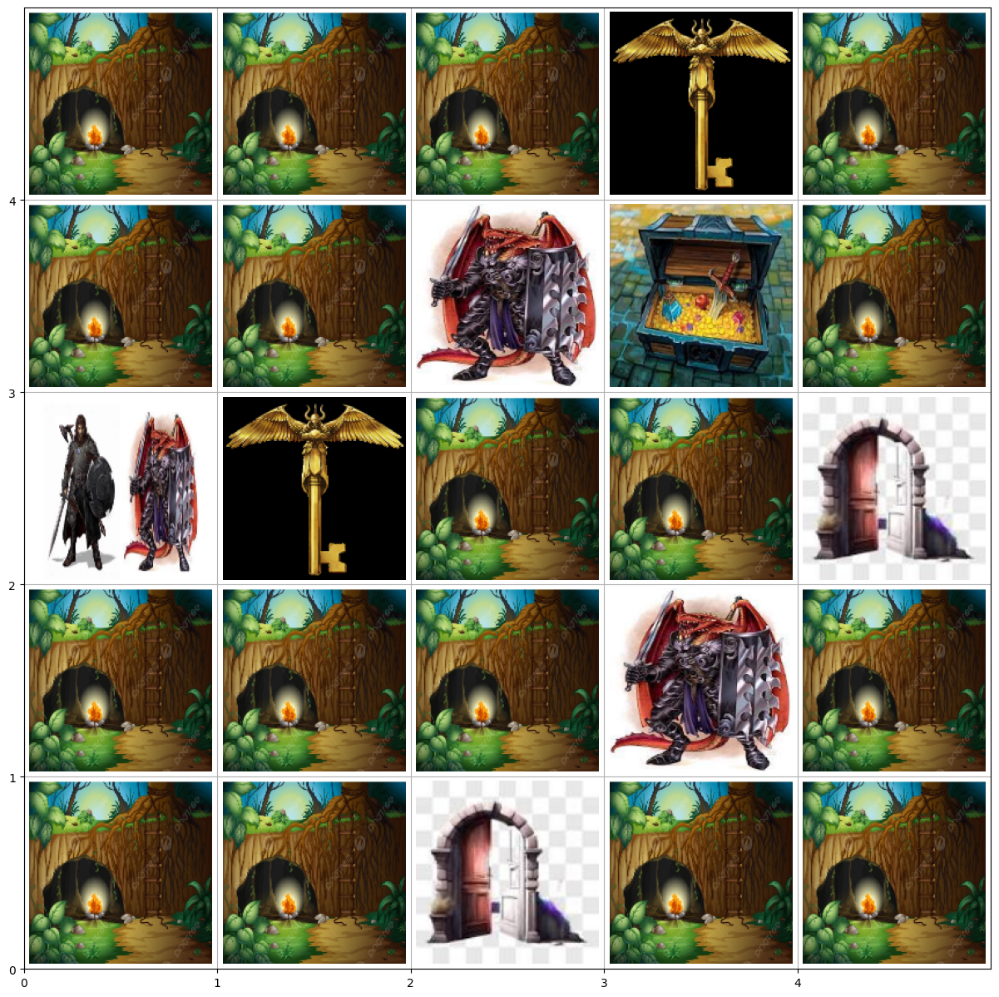

Next State: 15, Current State:10, Action: 0, Reward: 1


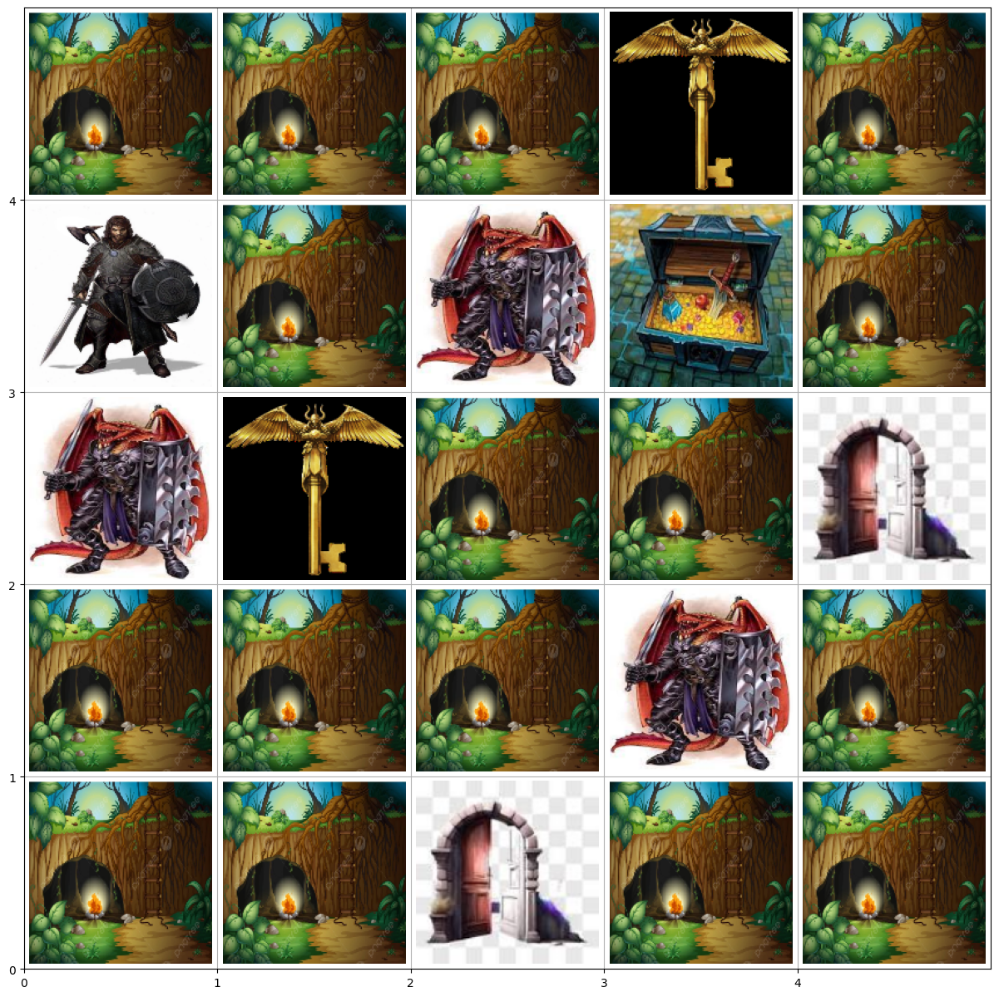

Next State: 15, Current State:15, Action: 3, Reward: -2


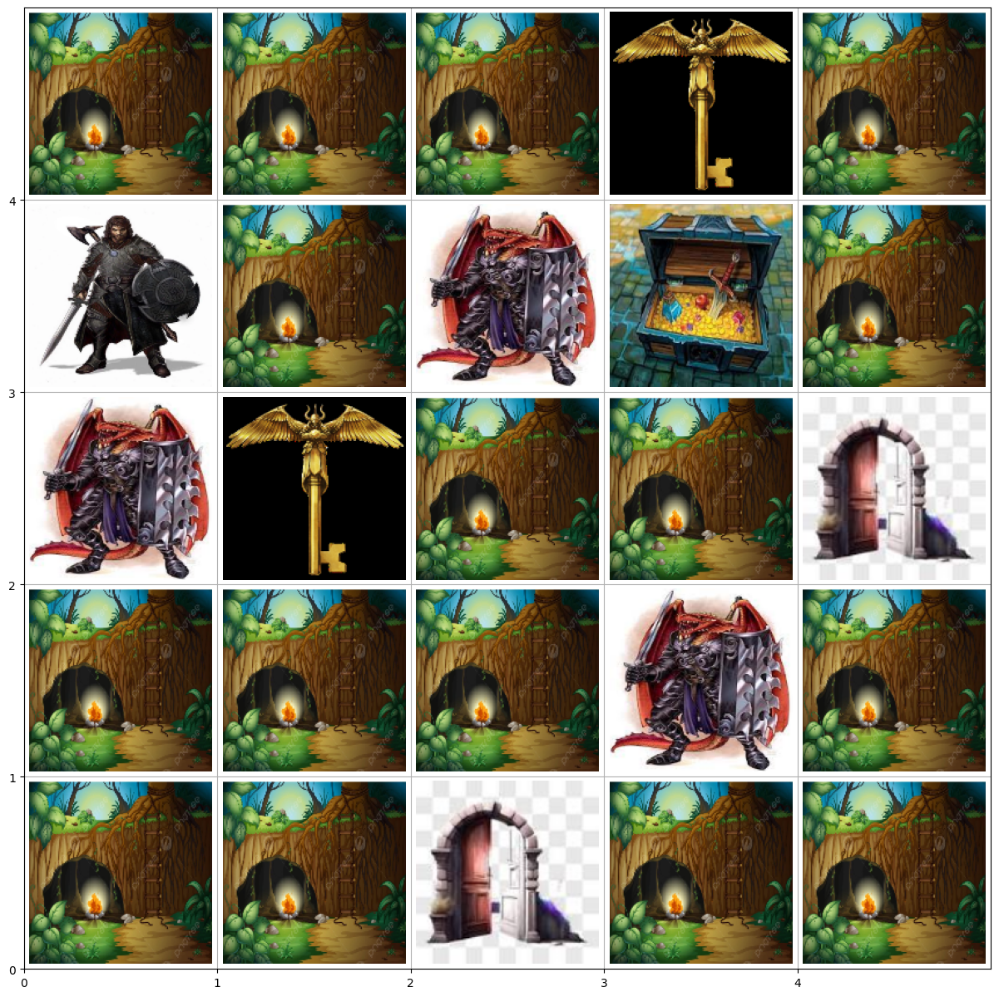

In [10]:
#Running player for at least 10 timesteps to show that the environment logic is defined correctly.

from ipywidgets import GridspecLayout
import time
env.reset()
env.render(plot=True)
for _ in range(10):
    action = env.action_space.sample()
    next_state, current_state, reward, done, _= env.step(action)

    print(f"Next State: {next_state}, Current State:{current_state}, Action: {action}, Reward: {reward}")
    env.render()
    time.sleep(1)



# **Part II: Implementation of SARSA**

In [12]:
#Applying SARSA algorithm to solve the Dungeon environment

env = DungeonEnvironment()

class SARSA_agent:
    def __init__(self, state_size, action_size, learning_rate=0.1, discount_factor=0.99, epsilon=1.0, epsilon_decay=0.99, min_epsilon=0.01, episodes = 100):
        self.state_size = state_size
        self.action_size = action_size
        self.learning_rate = learning_rate
        self.discount_factor = discount_factor
        self.epsilon = epsilon
        self.epsilon_decay = epsilon_decay
        self.min_epsilon = min_epsilon
        self.q_table = np.zeros((state_size, action_size))
        self.episodes = episodes

    def select_action(self, state):
        # applying greedy algo policy here. epsilon as probability of choosing random action
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.action_size)
        else:
            return np.argmax(self.q_table[state, :])

    def update_q_table(self, state, action, reward, next_state, next_action):
        current_q = self.q_table[state, action]
        next_q = self.q_table[next_state, next_action]
        updated_q = current_q + self.learning_rate * (reward + self.discount_factor * next_q - current_q)
        self.q_table[state, action] = updated_q

    def decay_epsilon(self):
        self.epsilon = max(self.min_epsilon, self.epsilon * self.epsilon_decay)


def run_sarsa(env, agent, steps=10):
    total_rewards = []

    for episode in range(agent.episodes):
        state = env.reset()
        action = agent.select_action(state)
        episode_reward = 0

        for _ in range(steps):
            next_state, state_c, reward, done, _ = env.step(action)
            next_action = agent.select_action(next_state)
            agent.update_q_table(state, action, reward, next_state, next_action)
            episode_reward += reward

            state = next_state
            action = next_action

            if done:
                break

        total_rewards.append(episode_reward)
        agent.decay_epsilon()

    return total_rewards

def run_greedy(env, agent, episodes=10, steps=10):
    total_rewards = []

    for episode in range(episodes):
        state = env.reset()
        episode_reward = 0

        for _ in range(steps):
            action = np.argmax(agent.q_table[state, :])
            next_state, _, reward, done, _ = env.step(action)
            episode_reward += reward

            state = next_state

            if done:
                break

        total_rewards.append(episode_reward)

    return total_rewards


In [13]:
#plot for evaluation results

def run_sarsa_with_evaluation(env, gamma = 0.99, epsilon_decay_rate=0.99, num_episodes = 100, episodes_for_greedy=100):
    env.reset()

    state_size = env.observation_space.n
    action_size = env.action_space.n
    sarsa_agent = SARSA_agent(state_size, action_size, discount_factor=gamma, epsilon_decay=epsilon_decay_rate, episodes=num_episodes)

    print("Initial Q-table:")
    print(sarsa_agent.q_table)

    # SARSA training phase
    total_rewards = run_sarsa(env, sarsa_agent)

    # Evaluation phase
    print("\nTrained Q-table:")
    print(sarsa_agent.q_table)

    # Rewards per episode plot
    plt.plot(total_rewards)
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')
    plt.title('Total Reward per Episode (SARSA)')
    plt.show()

    # Epsilon decay graph
    epsilon_values = [sarsa_agent.epsilon * (sarsa_agent.epsilon_decay ** i) for i in range(sarsa_agent.episodes)]
    plt.plot(epsilon_values)
    plt.xlabel('Episode')
    plt.ylabel('Epsilon Value')
    plt.title('Epsilon Decay (SARSA)')
    plt.show()

    # Greedy policy evaluation
    greedy_total_rewards = run_greedy(env, sarsa_agent, episodes=episodes_for_greedy)

    # Plot total rewards for the greedy policy
    plt.plot(greedy_total_rewards)
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')
    plt.title('Total Reward per Episode (Greedy Policy)')
    plt.show()
    return total_rewards

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 1.75566398e+00 -6.60199889e-01  6.17016174e+01 -6.09078647e-01]
 [ 6.43646407e+01  3.61261800e+01  1.57579006e+01  3.47024989e+01]
 [ 3.15988667e+00  7.15778462e+00  4.77112706e+01  5.88133485e-01]
 [-1.88834490e+00  4.45934930e+00  4.93508290e+01 -1.02562349e+00]
 [ 5.27576353e+01 -1.96960043e-01  1.56204163e-01  5.94998318e+00]
 [-7.83090570e+00  3.15474090e+00  6.23225085e+01 -2.47551143e-01]
 [ 1.50594070e+01  6.43427592e+01  3.03349018e+01  2.59345917e+01]
 [ 1.58733460e+00 -1.89525446e+00 -5.30123285e+00  5.53223288e+01]
 [ 6.28397968e+00 -3.48361259e-01  5.37011220e+01  3.

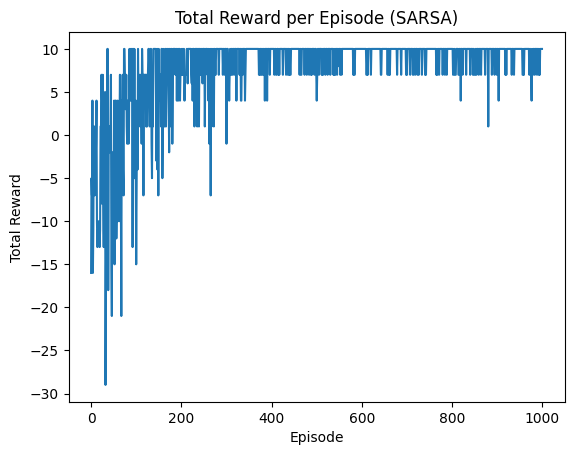

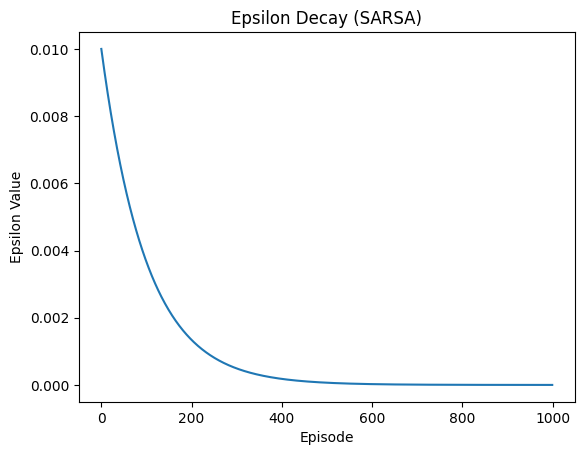

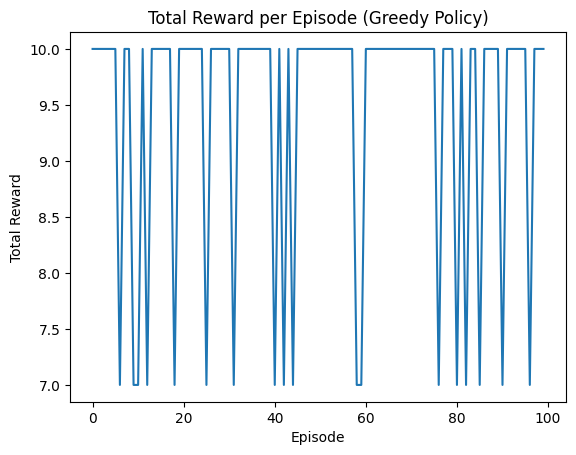

In [14]:
#Intial q-table
q_learning_rewards = run_sarsa_with_evaluation(env, num_episodes=1000)


In [15]:
#hyperparameter optimization

def objective(trial):
    env.reset()

    state_size = env.observation_space.n
    action_size = env.action_space.n

    gamma = trial.suggest_float('gamma', 0.8, 0.99)
    epsilon_decay_rate = trial.suggest_float('epsilon_decay_rate', 0.9, 0.99)
    num_episodes = trial.suggest_int('num_episodes', 100, 1500)
    sarsa_agent = SARSA_agent(state_size, action_size, discount_factor=gamma, epsilon_decay = epsilon_decay_rate, episodes=num_episodes)

    total_rewards = run_sarsa(env, sarsa_agent)

    #since our rewards is positive and total_reards is minimized quantity by optuna, we need to negate it.
    return -np.mean(total_rewards)

study = optuna.create_study(direction='minimize')

study.optimize(objective, n_trials=30)

best_params = study.best_params
print(f"Best Hyperparameters: {best_params}")

best_trial = study.best_trial
print(f"Best Trial: {best_trial}")

[I 2023-12-08 01:56:37,829] A new study created in memory with name: no-name-ef8d8f69-4edd-4f2f-af49-5afd1f86dab4
[I 2023-12-08 01:56:38,021] Trial 0 finished with value: -5.843601895734597 and parameters: {'gamma': 0.8582553873969323, 'epsilon_decay_rate': 0.9785875698686911, 'num_episodes': 211}. Best is trial 0 with value: -5.843601895734597.
[I 2023-12-08 01:56:38,404] Trial 1 finished with value: -9.064197530864197 and parameters: {'gamma': 0.8835586437132554, 'epsilon_decay_rate': 0.9006553813584428, 'num_episodes': 405}. Best is trial 1 with value: -9.064197530864197.
[I 2023-12-08 01:56:38,477] Trial 2 finished with value: -5.396551724137931 and parameters: {'gamma': 0.8951075270780919, 'epsilon_decay_rate': 0.9633261429739106, 'num_episodes': 116}. Best is trial 1 with value: -9.064197530864197.
[I 2023-12-08 01:56:39,588] Trial 3 finished with value: -8.70607553366174 and parameters: {'gamma': 0.8225387459032584, 'epsilon_decay_rate': 0.9781176671153217, 'num_episodes': 1218}

Best Hyperparameters: {'gamma': 0.8156728993974587, 'epsilon_decay_rate': 0.9253689258771236, 'num_episodes': 1488}
Best Trial: FrozenTrial(number=25, state=TrialState.COMPLETE, values=[-13.067204301075268], datetime_start=datetime.datetime(2023, 12, 8, 1, 56, 58, 984867), datetime_complete=datetime.datetime(2023, 12, 8, 1, 57, 0, 580478), params={'gamma': 0.8156728993974587, 'epsilon_decay_rate': 0.9253689258771236, 'num_episodes': 1488}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'gamma': FloatDistribution(high=0.99, log=False, low=0.8, step=None), 'epsilon_decay_rate': FloatDistribution(high=0.99, log=False, low=0.9, step=None), 'num_episodes': IntDistribution(high=1500, log=False, low=100, step=1)}, trial_id=25, value=None)


# HyperParam1 - decay rate
values :
* 0.90
* 0.95
* 0.99

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 0.46120613 -0.15308087 16.45753709 -0.2       ]
 [17.76504408 -0.3701     -1.80340735  0.2148688 ]
 [ 0.         -1.17407116  0.          2.16550985]
 [ 2.57172039  0.          0.          0.        ]
 [ 0.          0.          4.53045574  0.        ]
 [-1.         13.65439289  0.4390823  -0.70522135]
 [ 0.1         0.72178833 19.16042765  0.94004218]
 [ 0.29018541 -1.66035657 -3.80904322 19.21547349]
 [ 1.46666138  0.          0.          0.        ]
 [ 3.18606001  0.          0.          0.        ]
 [ 3.9886232   0.          0.          0.        ]
 [ 1.57387063  0.          0

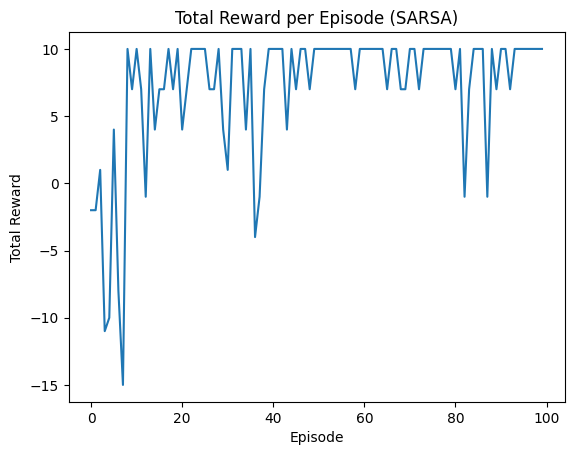

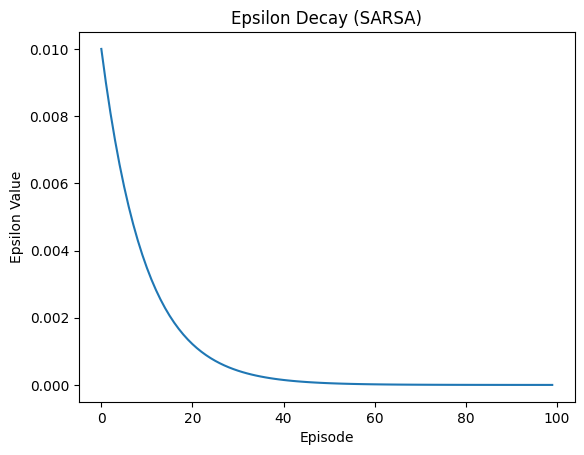

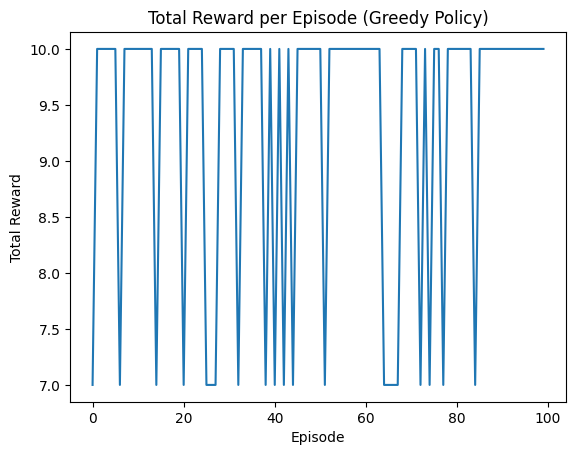

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 0.87160688  2.13647423 21.16882461  1.05002595]
 [ 1.46759159  0.44246152 -2.77840752 21.207568  ]
 [ 0.07561    -0.7211738   4.1621779   0.05086407]
 [-1.88873886  0.95482254  0.          0.        ]
 [ 0.          0.          0.          0.        ]
 [-3.42019    16.16362499  0.22446849 -0.14763659]
 [ 0.29996305  4.07592537  0.1        -0.0881    ]
 [ 0.1        -0.54524093 -1.899901    3.66745568]
 [ 1.16918775  0.05493651  0.         -0.34630195]
 [ 2.34194552  0.          0.          0.        ]
 [ 0.58701978 -0.20392232  0.          1.48578387]
 [ 2.6249615   0.          0

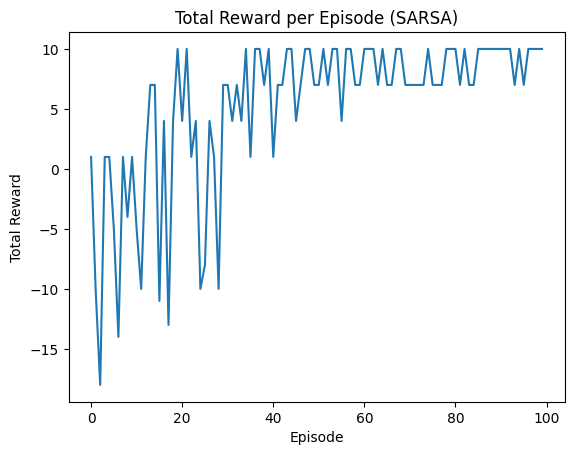

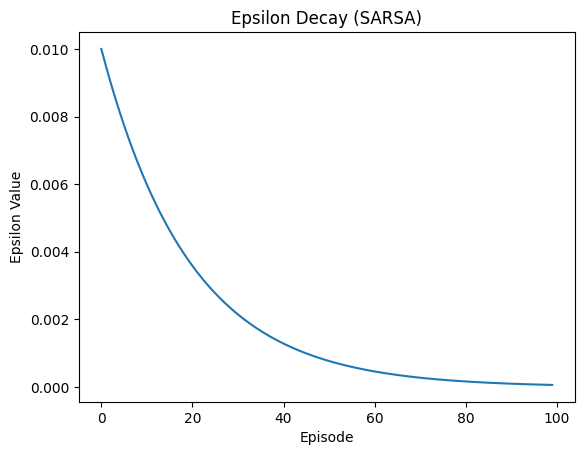

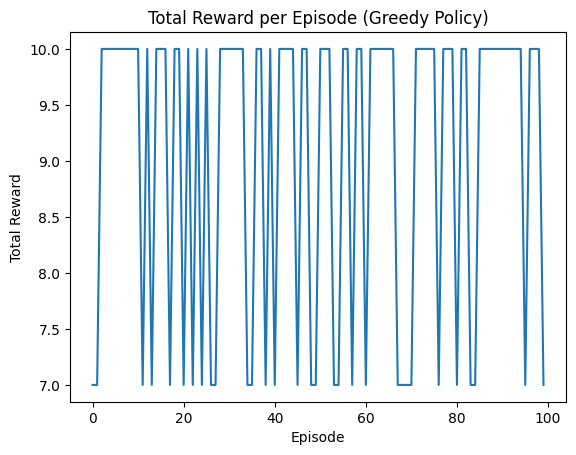

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 0.84683068 -2.39834257  2.63724708 -1.66357949]
 [ 3.43424963 -0.66015788 -3.81912169  1.27818948]
 [ 0.38557598 -0.57607358  1.45972309  0.55171676]
 [-2.71114565 -0.49891532  0.95508832 -1.35865191]
 [-0.0837062  -0.16362068  0.          0.36184309]
 [-7.53614114  0.92784051  2.58727018 -1.28161183]
 [ 0.98578673  3.62970836  1.19969606  1.70504614]
 [ 0.61818882 -2.61208763 -4.00445392  1.99458268]
 [ 0.20645711  0.00780637  0.79740972 -0.0306816 ]
 [-0.5         0.3175108  -0.18279365 -1.42080418]
 [ 0.58388784 -0.35945685  0.3252144  -0.73985686]
 [ 0.1         0.91326129  0

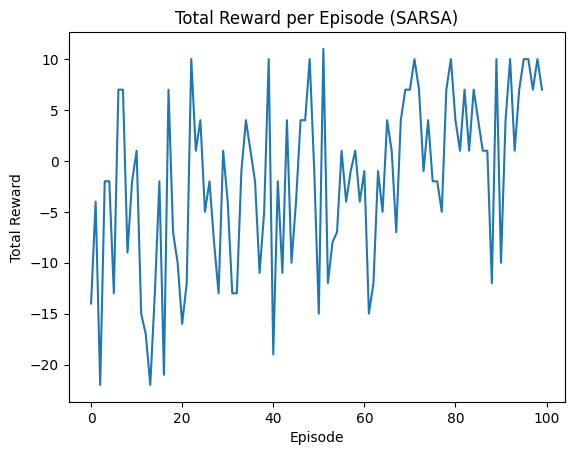

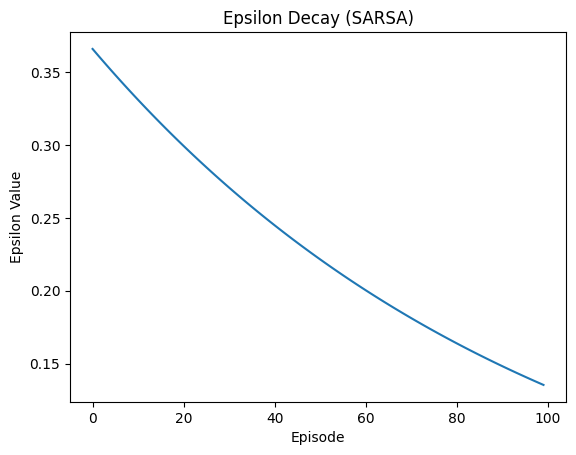

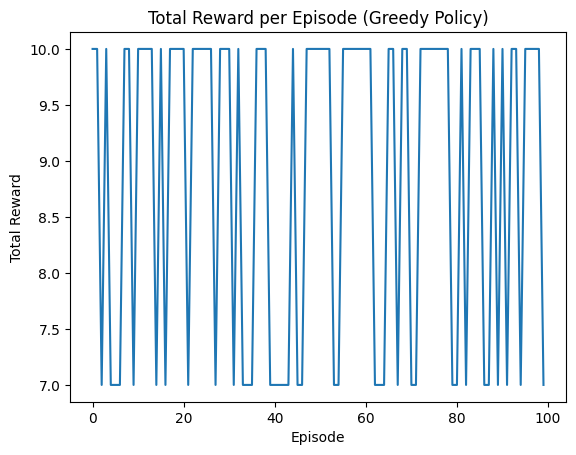

In [18]:
# running an SARSA agent with three different epsilon decay rates
decay_params = [0.9,0.95,0.99]
env = DungeonEnvironment()

for d in decay_params:
    run_sarsa_with_evaluation(env, epsilon_decay_rate=d)




# HyperParam2 - number of episodes
values :
* 300
* 600
* 1200

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 1.97177717e+00 -1.39380218e+00  1.17475870e+01 -4.18728813e-01]
 [ 1.71194313e+01  1.59329592e+00 -3.24180214e+00  3.18731874e+00]
 [ 4.93140619e-01 -1.23202737e+00  8.07069655e+00  2.57936317e+00]
 [-1.61814997e+00 -7.98733584e-01  6.06998642e+00 -1.69469957e+00]
 [-3.92624790e-01 -6.85460826e-01 -2.29754959e-01  4.59721552e+00]
 [-7.77018546e+00  2.88722524e+00  1.42385306e+01  4.12284378e-01]
 [ 1.82513488e+01  6.75059506e+00  5.83585271e+00  8.33353529e+00]
 [ 1.39469908e+00  3.01508844e-02 -3.37009993e+00  1.02736391e+01]
 [ 4.53193615e+00  1.36710676e-01  1.00000000e-03  1.

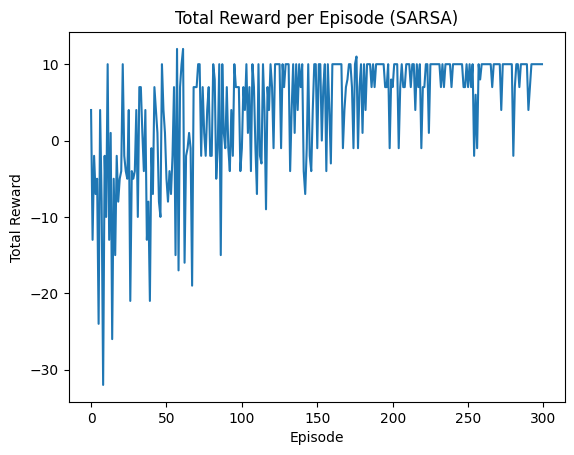

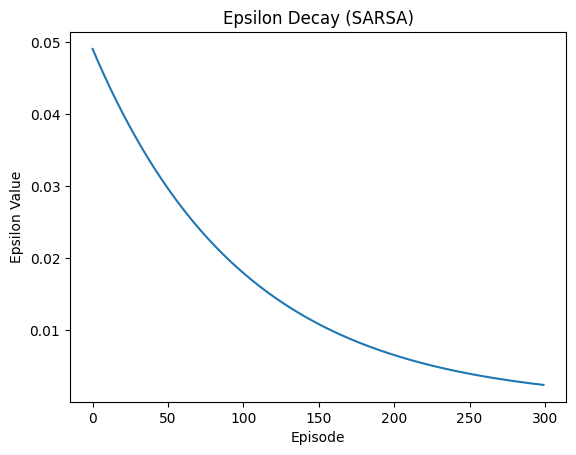

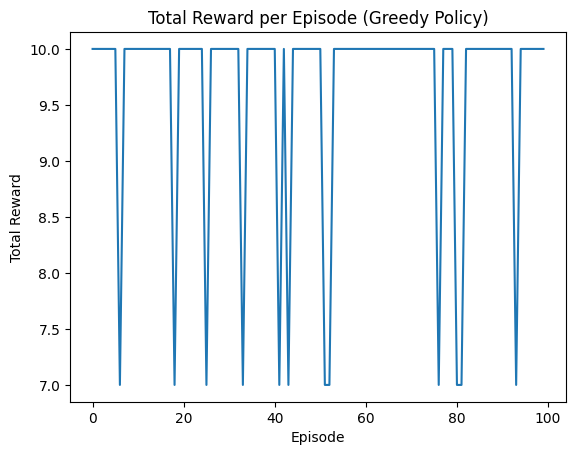

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 2.52624896e+00  2.57239406e+00  4.55786841e+01  1.51825408e+00]
 [ 4.86622725e+01  1.66222661e+01  5.31873476e+00  1.30394833e+01]
 [ 2.79624112e-01 -3.69782968e-01  2.78172303e+01  9.57295328e-01]
 [-4.36222432e+00 -5.16263164e-01  3.15621944e+01 -1.27288416e+00]
 [ 1.16216073e+00 -6.64532514e-01 -5.22519417e-01  2.31198881e+01]
 [-7.51229024e+00  9.01914929e+00  4.43375521e+01  1.94396868e+00]
 [ 1.36245640e+01  4.86030986e+01  1.22594376e+01  1.67668568e+01]
 [ 1.87699909e+00 -1.89968696e+00 -6.75962181e+00  3.08176410e+01]
 [-2.93256364e-01 -2.97452458e-01  6.42594608e-01  1.

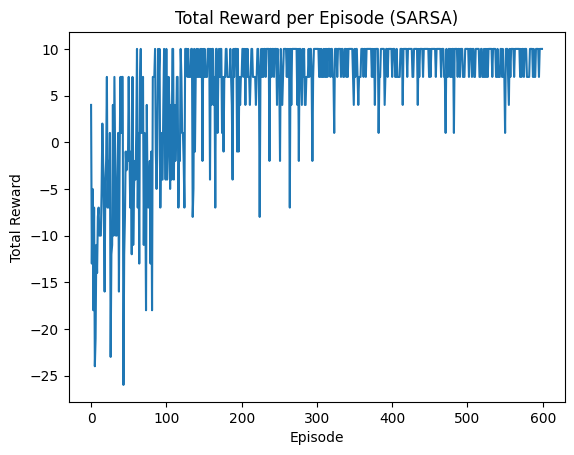

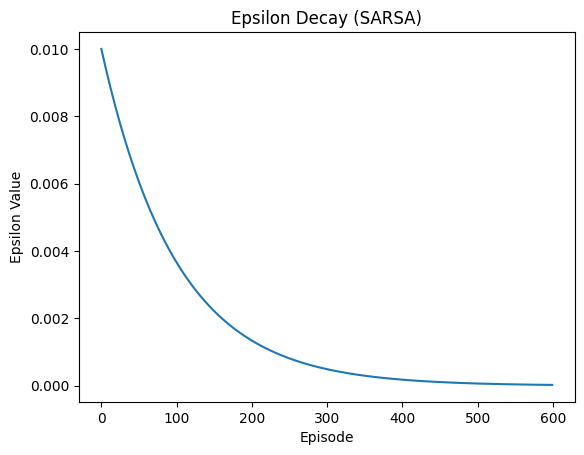

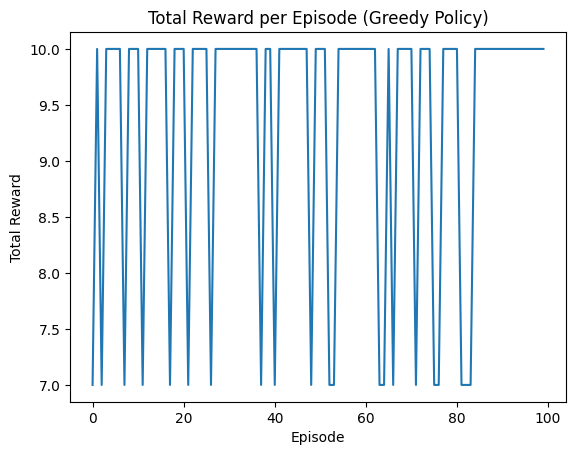

Initial Q-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q-table:
[[ 6.76223463e+01 -6.14857976e-01  1.76837072e+00  4.89159353e+00]
 [ 6.82577587e+01  1.29633787e+01  5.52064444e+00  1.32582435e+01]
 [ 1.93132241e-01 -5.41083941e-01  6.08697003e+01  3.18280573e-01]
 [ 2.55394626e+00 -7.76897752e-01  6.07510940e+01  5.89229277e-01]
 [ 6.01700911e+01 -1.14864142e+00 -1.40488784e-01 -1.85196875e-01]
 [-1.16384622e+00  1.33894920e+01  6.80527300e+01  1.65679454e+01]
 [ 6.60907643e+01  3.39044297e+01  2.32932962e+01  2.24345619e+01]
 [ 1.61865982e+00 -4.28217038e-01  3.07125378e+00  5.81658906e+01]
 [ 1.52895325e-02  5.89381959e-02  5.99221323e+01 -2.

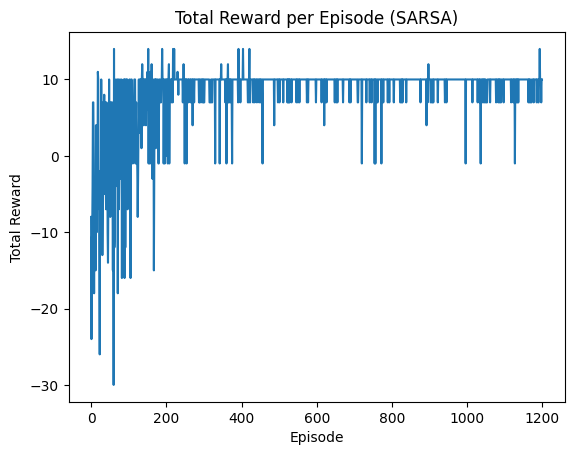

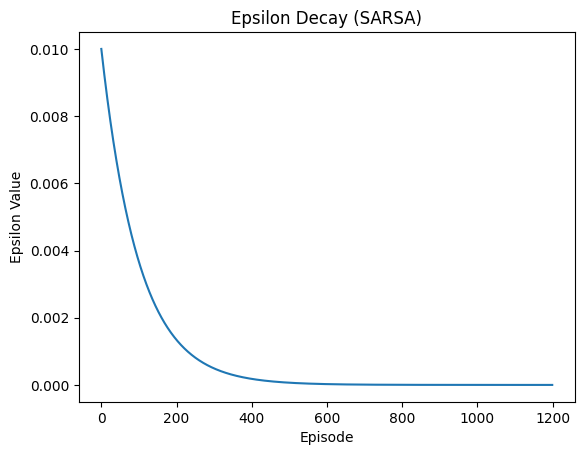

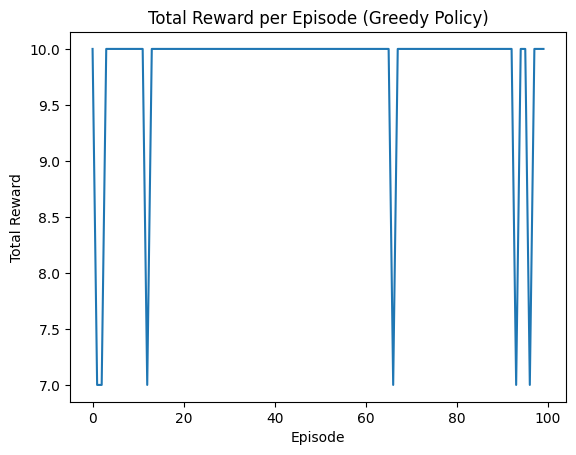

In [19]:
# running an SARSA agent with three different episode values

episodes = [300,600,1200]

for e in episodes:
    run_sarsa_with_evaluation(env, num_episodes=e)



# **Analysis**

Total Reward per Episode (SARSA Training Phase):
A rising trend indicates the agent is learning and improving its policy. Fluctuations may be normal, but a consistently low trend may suggest issues with the agent's learning.

Epsilon Decay (SARSA Training Phase):
Basic idea is that a smooth decay indicates a well-balanced exploration-exploitation strategy. Rapid decay might result in premature convergence.

Total Reward per Episode (Greedy Policy Evaluation):
A rising trend indicates the effectiveness of the learned policy. If the total rewards remain high, it suggests that the agent's learned policy is performing well in exploiting its knowledge. However, a declining trend may indicate a lack of generalization or overfitting.


Hyperparameter Analysis:

Gamma (Discount Factor): A higher gamma values give more weight to future rewards, potentially making the agent more far-sighted.We are looking for a good balance between short-term and long-term rewards
We can observe from Total Reward per Episode (SARSA Training Phase) and Epsilon Decay graphs that,
1. The increase in gamma value is creating a more importance sitatution for future scenarios, there  by converging the learning process.
2. The epsilon decay can be seen to move towards the center indicating a more fluctuation due to policy not improving with agent giving importance to future instances.
Epsilon Decay Rate: A slower decay allows more exploration throughout training, while a faster decay shifts the agent towards exploitation sooner. We need to find a balance that ensures effective learning without prematurely converging to suboptimal policies.

Number of episodes: Too few episodes may result in an undertrained agent, while too many episodes might lead to overfitting.
From the training phase rewards per episode graph we can clearly see that when the number of episodes is less the consistency of learning is not good indicating an underfit. Particularly we can look at the rise of rewards oscillating and the trend continuing further. We can also see from hyperparameter tuning with optuna that the best possible value for number of epides hyperparameter is around 830


#  **Part III: Implemention of  Double Q-learning**

In [20]:
#Applying Double Q-learning algorithm to solve the environment

class DoubleQLearningAgent:
    def __init__(self, state_size, action_size, learning_rate=0.1, discount_factor=0.99, epsilon=1.0, epsilon_decay=0.99, min_epsilon=0.01, episodes=100):
        self.state_size = state_size
        self.action_size = action_size
        self.learning_rate = learning_rate
        self.discount_factor = discount_factor
        self.epsilon = epsilon
        self.epsilon_decay = epsilon_decay
        self.min_epsilon = min_epsilon
        self.q1_table = np.zeros((state_size, action_size))  # Q1-values
        self.q2_table = np.zeros((state_size, action_size))  # Q2 Values
        self.episodes = episodes

    def select_action(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.action_size)
        else:
            return np.argmax(self.q1_table[state, :] + self.q2_table[state, :])

    def update_q_tables(self, state, action, reward, next_state):
        if np.random.rand() < 0.5:  # Randomly choose which Q-table to update
            max_action_next = np.argmax(self.q1_table[next_state, :])
            self.q1_table[state, action] += self.learning_rate * (reward + self.discount_factor * self.q2_table[next_state, max_action_next] - self.q1_table[state, action])
        else:
            max_action_next = np.argmax(self.q2_table[next_state, :])
            self.q2_table[state, action] += self.learning_rate * (reward + self.discount_factor * self.q1_table[next_state, max_action_next] - self.q2_table[state, action])

    def decay_epsilon(self):
        self.epsilon = max(self.min_epsilon, self.epsilon * self.epsilon_decay)

def run_double_q_learning(env, agent, steps=10):
    total_rewards = []

    for episode in range(agent.episodes):
        state = env.reset()
        episode_reward = 0

        for _ in range(steps):
            action = agent.select_action(state)
            next_state, _, reward, done, _ = env.step(action)
            agent.update_q_tables(state, action, reward, next_state,)
            episode_reward += reward

            state = next_state

            if done:
                break

        total_rewards.append(episode_reward)
        agent.decay_epsilon()

    return total_rewards

def run_greedy_double_q_learning(env, agent, episodes=10, steps=10):
    total_rewards = []

    for episode in range(episodes):
        state = env.reset()
        episode_reward = 0

        for _ in range(steps):
            action = np.argmax(agent.q1_table[state, :] + agent.q2_table[state, :])
            next_state, _, reward, done, _ = env.step(action)
            episode_reward += reward

            state = next_state

            if done:
                break

        total_rewards.append(episode_reward)

    return total_rewards


In [21]:
#plot for evaluation results

def run_double_q_learning_with_evaluation(env, gamma=0.99, epsilon_decay_rate=0.99, num_episodes=100, episodes_for_greedy=100):
    env.reset()

    state_size = env.observation_space.n
    action_size = env.action_space.n
    double_q_agent = DoubleQLearningAgent(state_size, action_size, discount_factor=gamma, epsilon_decay=epsilon_decay_rate, episodes=num_episodes)

    print("Initial Q1-table:")
    print(double_q_agent.q1_table)
    print("\nInitial Q2-table:")
    print(double_q_agent.q2_table)

    # Double Q-learning training phase
    total_rewards = run_double_q_learning(env, double_q_agent)

    # Evaluation phase
    print("\nTrained Q1-table:")
    print(double_q_agent.q1_table)
    print("\nTrained Q2-table:")
    print(double_q_agent.q2_table)

    # Rewards per episode plot
    plt.plot(total_rewards)
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')
    plt.title('Total Reward per Episode (Double Q-learning)')
    plt.show()

    # Epsilon decay graph
    epsilon_values = [double_q_agent.epsilon * (double_q_agent.epsilon_decay ** i) for i in range(double_q_agent.episodes)]
    plt.plot(epsilon_values)
    plt.xlabel('Episode')
    plt.ylabel('Epsilon Value')
    plt.title('Epsilon Decay (Double Q-learning)')
    plt.show()

    # Greedy policy evaluation
    greedy_total_rewards = run_greedy_double_q_learning(env, double_q_agent, episodes=episodes_for_greedy)

    # Plot total rewards for the greedy policy
    plt.plot(greedy_total_rewards)
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')
    plt.title('Total Reward per Episode (Greedy Policy - Double Q-learning)')
    plt.show()
    return total_rewards


Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 4.13767726e+01  3.71910730e+01  8.51195971e+01  2.18220416e+01]
 [ 2.34672816e+01  5.05014526e+01  9.48216405e+00  8.53263935e+01]
 [ 8.04064712e-01  1.18141402e+00  4.36339000e-01  7.00957

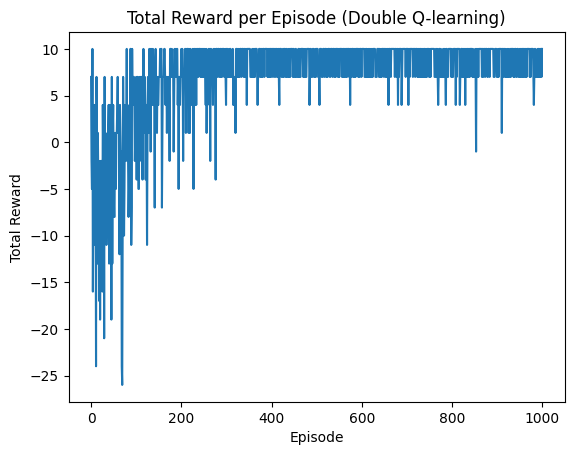

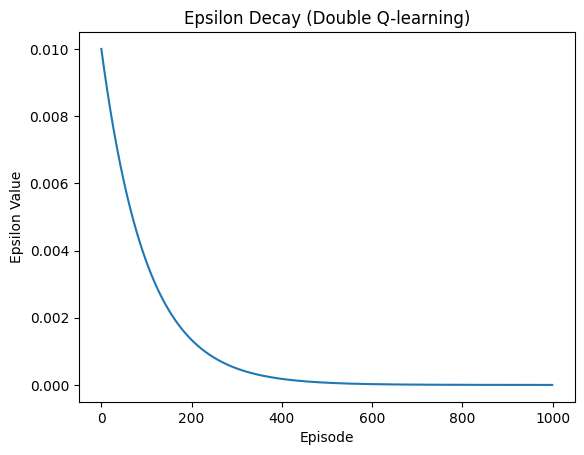

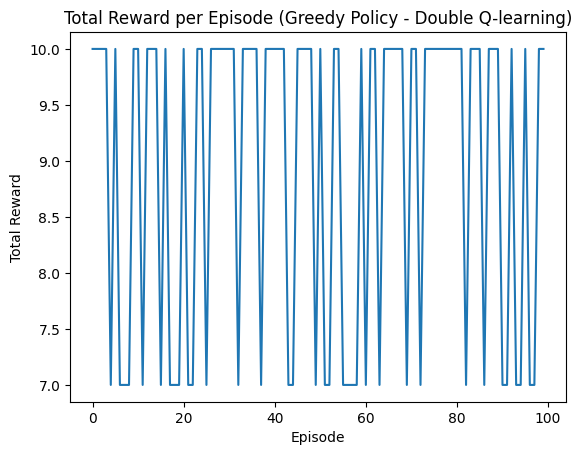

In [22]:
double_q_learning_rewards= run_double_q_learning_with_evaluation(env, num_episodes=1000)


In [23]:
#hyperparameter optimization

def objective(trial):
    env.reset()

    state_size = env.observation_space.n
    action_size = env.action_space.n

    gamma = trial.suggest_float('gamma', 0.8, 0.99)
    epsilon_decay_rate = trial.suggest_float('epsilon_decay_rate', 0.9, 0.99)
    num_episodes = trial.suggest_int('num_episodes', 100, 1500)

    double_q_agent = DoubleQLearningAgent(state_size,action_size, discount_factor=gamma, epsilon_decay=epsilon_decay_rate, episodes=num_episodes)

    total_rewards = run_double_q_learning(env, double_q_agent)

    # As we're using minimization and rewards are positive, we negate them for minimization purposes
    return -np.mean(total_rewards)

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=30)

best_params = study.best_params
print(f"Best Hyperparameters: {best_params}")

best_trial = study.best_trial
print(f"Best Trial: {best_trial}")


[I 2023-12-08 01:58:04,506] A new study created in memory with name: no-name-ac665374-ec87-4fa6-8265-8cf51ecc3df5
[I 2023-12-08 01:58:05,418] Trial 0 finished with value: -8.88170731707317 and parameters: {'gamma': 0.9048255554726069, 'epsilon_decay_rate': 0.9103951183706059, 'num_episodes': 820}. Best is trial 0 with value: -8.88170731707317.
[I 2023-12-08 01:58:05,587] Trial 1 finished with value: -8.259493670886076 and parameters: {'gamma': 0.8078312630398864, 'epsilon_decay_rate': 0.9283843623649473, 'num_episodes': 158}. Best is trial 0 with value: -8.88170731707317.
[I 2023-12-08 01:58:06,620] Trial 2 finished with value: -9.133474576271187 and parameters: {'gamma': 0.828372013005291, 'epsilon_decay_rate': 0.9404382642306197, 'num_episodes': 1416}. Best is trial 2 with value: -9.133474576271187.
[I 2023-12-08 01:58:06,794] Trial 3 finished with value: -6.963636363636364 and parameters: {'gamma': 0.979608783983739, 'epsilon_decay_rate': 0.9684965601948263, 'num_episodes': 275}. Be

Best Hyperparameters: {'gamma': 0.8836499921495582, 'epsilon_decay_rate': 0.9265303677553329, 'num_episodes': 1208}
Best Trial: FrozenTrial(number=14, state=TrialState.COMPLETE, values=[-11.46523178807947], datetime_start=datetime.datetime(2023, 12, 8, 1, 58, 12, 842360), datetime_complete=datetime.datetime(2023, 12, 8, 1, 58, 13, 551359), params={'gamma': 0.8836499921495582, 'epsilon_decay_rate': 0.9265303677553329, 'num_episodes': 1208}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'gamma': FloatDistribution(high=0.99, log=False, low=0.8, step=None), 'epsilon_decay_rate': FloatDistribution(high=0.99, log=False, low=0.9, step=None), 'num_episodes': IntDistribution(high=1500, log=False, low=100, step=1)}, trial_id=14, value=None)


Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 0.11881    -0.18119    11.93074699 -0.344261  ]
 [14.48052872 -0.25059169 -0.69525767  0.89518858]
 [ 0.          0.          0.39647269  0.        ]
 [ 0.          0.          1.57819319  

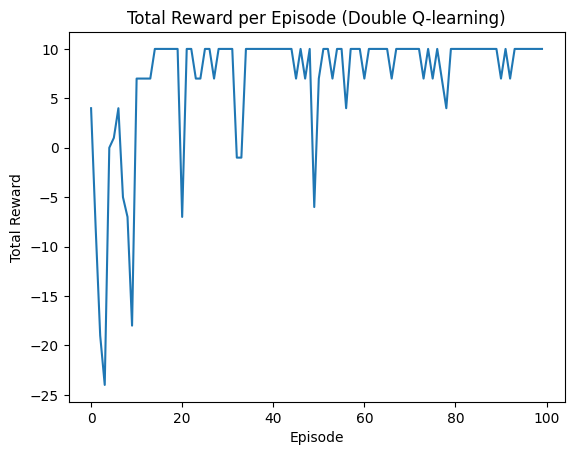

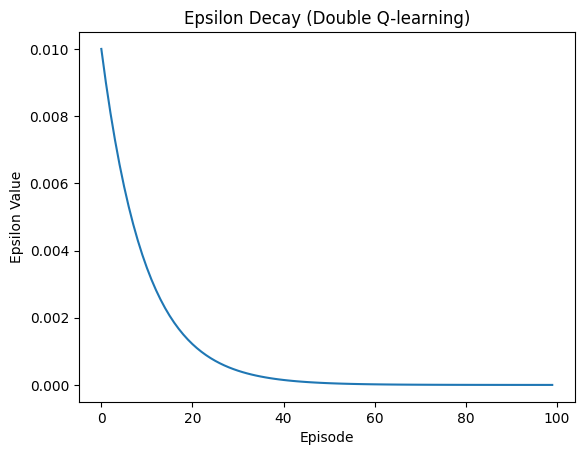

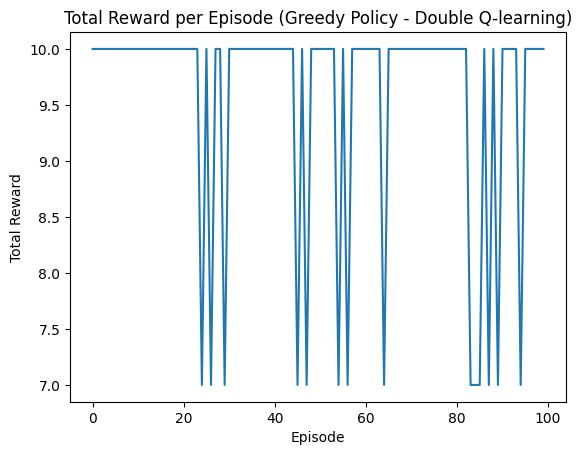

Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 2.43943928 -0.75839345  0.13162519 -0.36119   ]
 [ 6.13854302  0.         -0.4901      0.30130744]
 [ 3.36862109  0.          0.          0.13162519]
 [ 0.          0.          0.68904755  

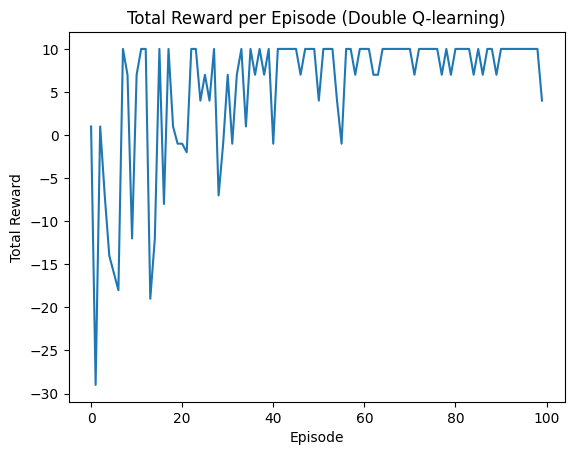

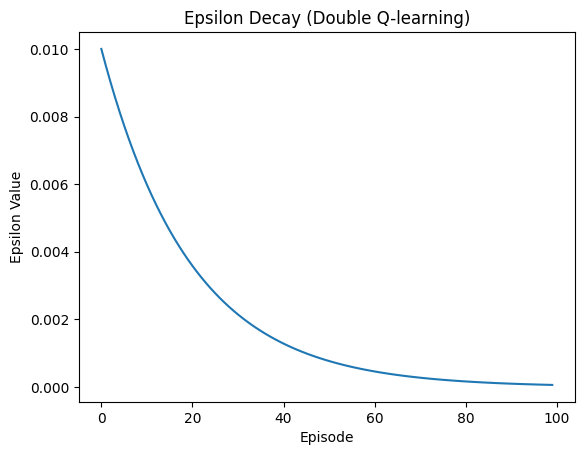

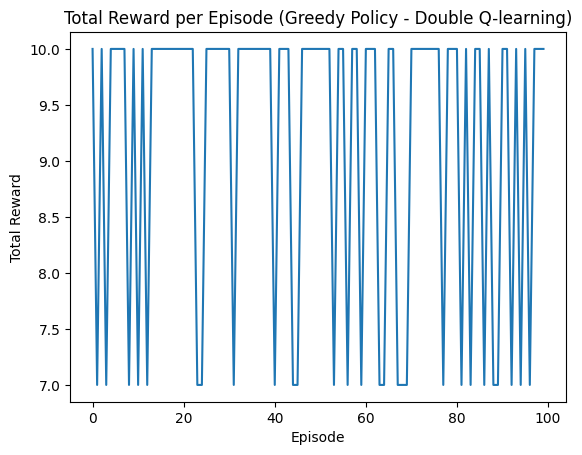

Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 0.79603234 -0.70658628  4.17373435 -0.25213125]
 [ 6.05833333  0.1874347  -2.45577306  2.72850516]
 [ 1.79805547 -0.22903012  0.16128109  0.88238504]
 [-0.91        0.          0.1        -

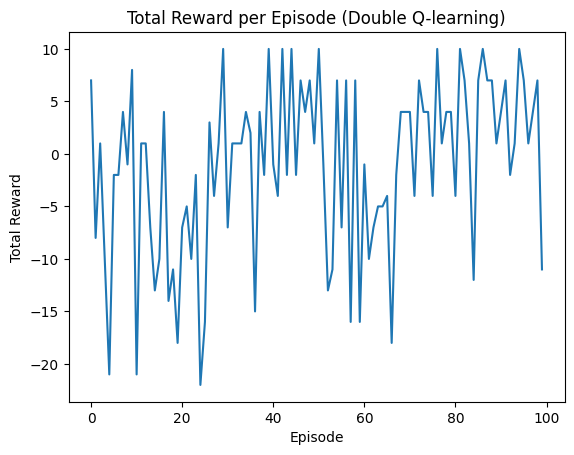

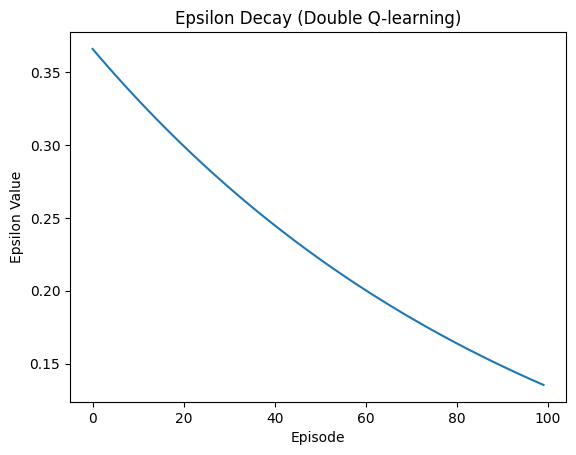

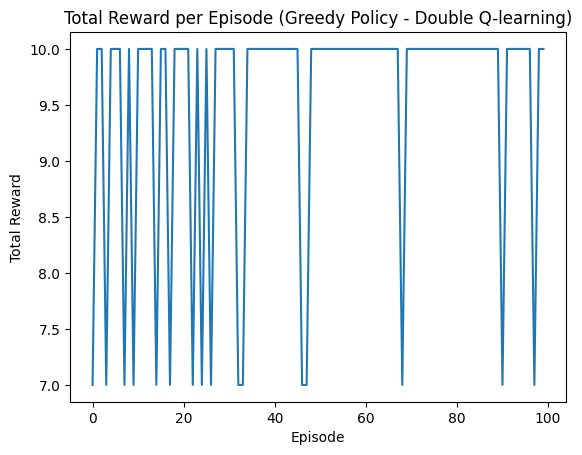

In [24]:
#running an Double-Qlearning for three different epsilon decay rates

decay_params = [0.9,0.95,0.99]
env = DungeonEnvironment()

for d in decay_params:
    run_double_q_learning_with_evaluation(env, epsilon_decay_rate=d)

Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 3.03116769  6.977074   21.67883705  5.77845071]
 [ 3.36972598  6.63176486 -3.18356764 22.06191557]
 [ 0.37114258  0.32784258  6.27492333  2.30834342]
 [-4.53329083  0.12061344  4.44823799 -

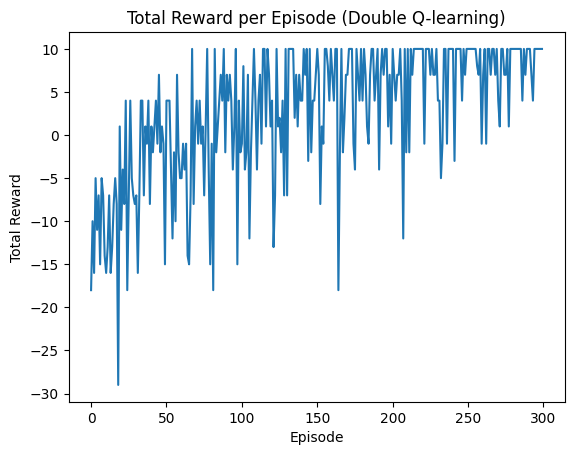

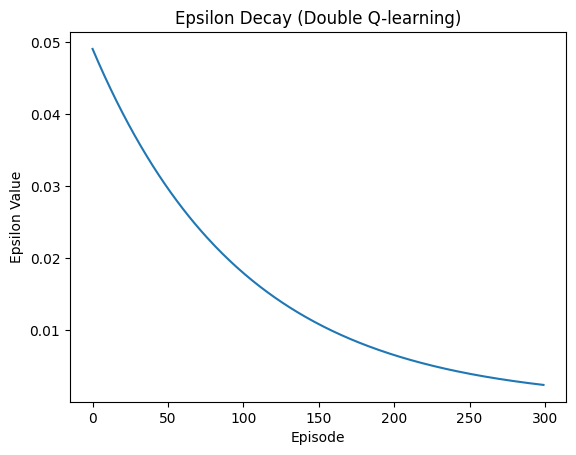

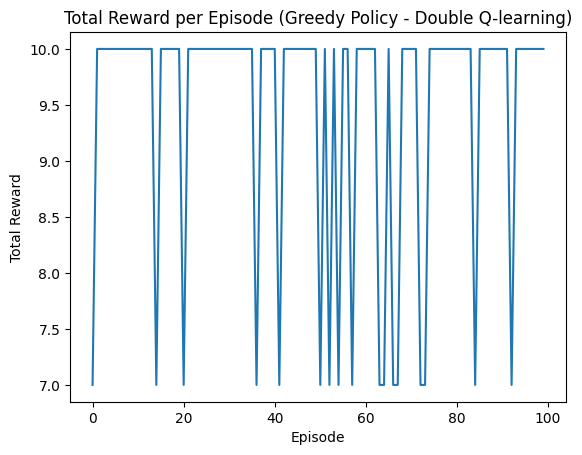

Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 1.75215187e+00  6.28010224e+00  5.50356565e+01  2.39479954e+00]
 [ 5.81664789e+01  1.39169429e+01  2.71144826e+00  1.88425320e+01]
 [ 7.19874910e-01 -8.45728435e-03  1.27944395e+00  2.86886

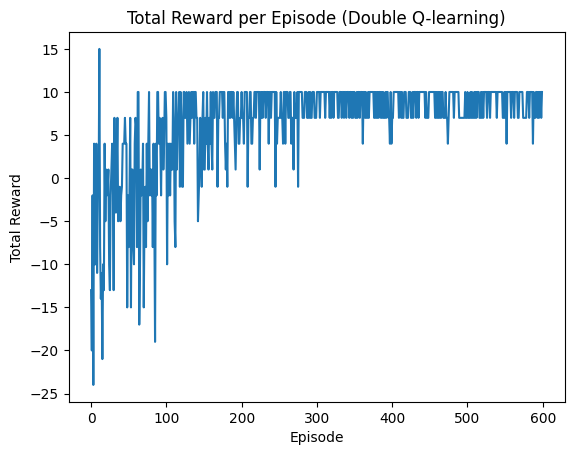

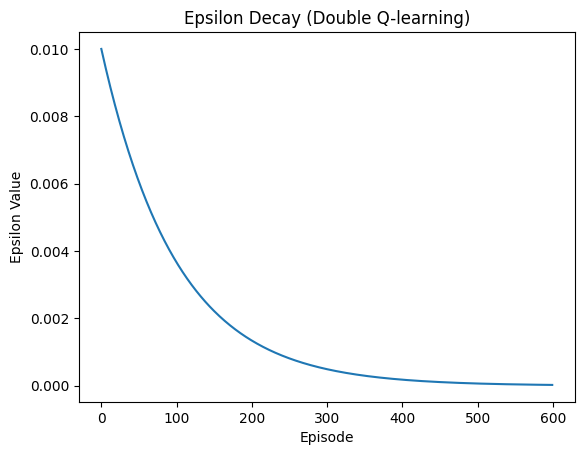

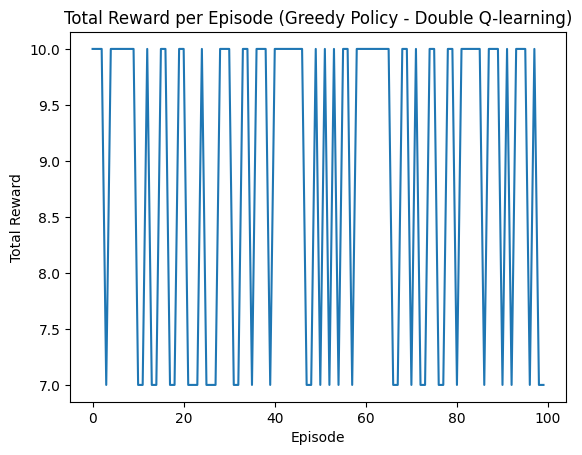

Initial Q1-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Initial Q2-table:
[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]

Trained Q1-table:
[[ 8.41022326e+01  5.08985980e+00  3.34126429e+00  3.34084174e+00]
 [ 2.58555750e+00  8.49154574e-01  9.01984265e+00  8.14769145e+01]
 [ 6.11967398e+01  8.07819587e+00  1.99900000e-01  3.03323

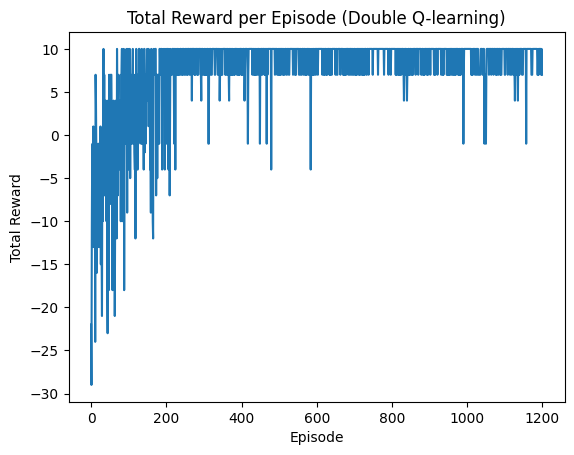

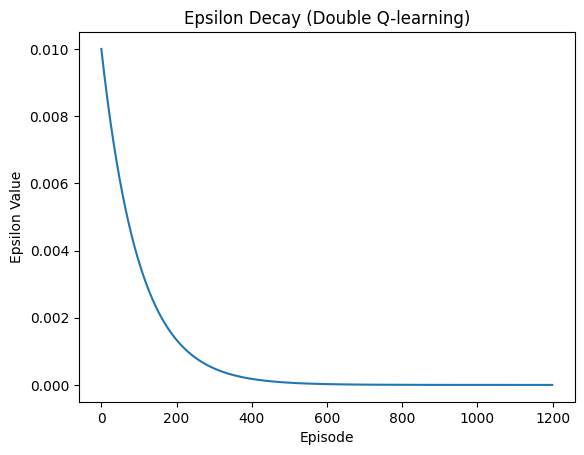

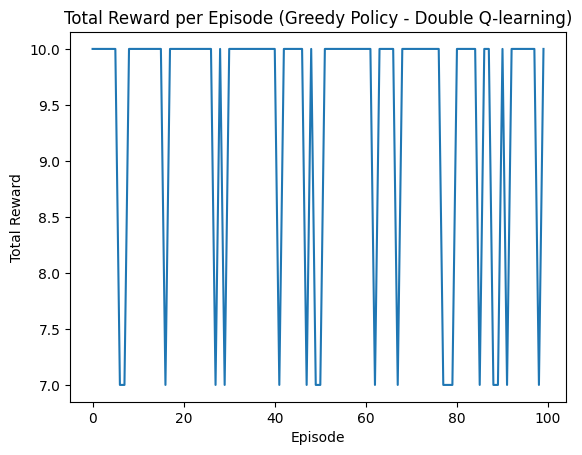

In [25]:
#running an Double-Qlearning for three different episode values.

episodes = [300,600,1200]

for e in episodes:
    run_double_q_learning_with_evaluation(env, num_episodes=e)

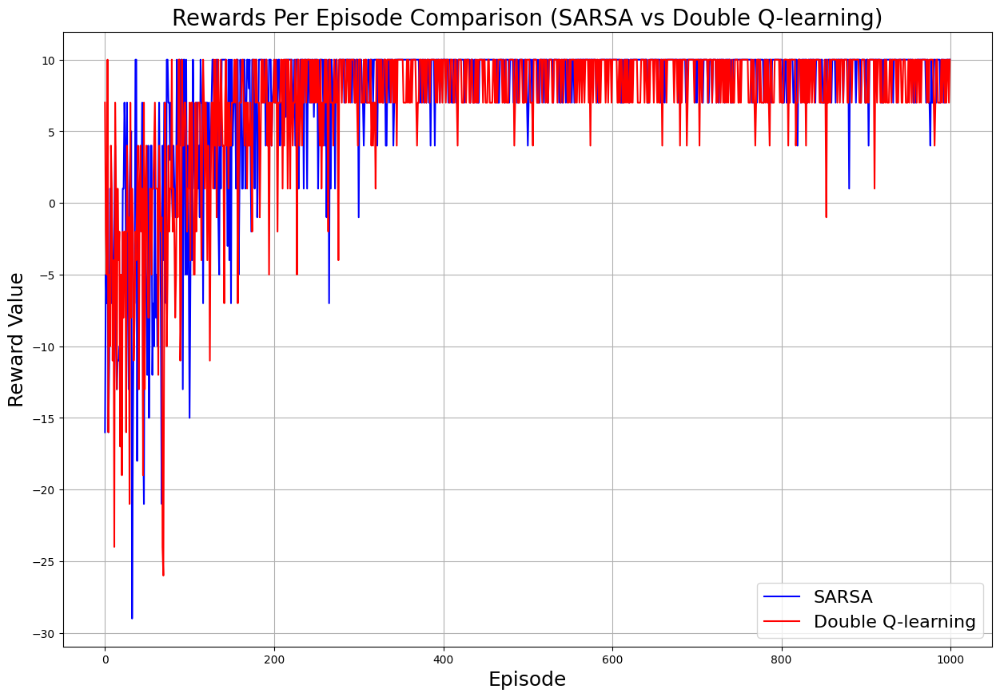

In [26]:
# comparison plot between the rewards obtained per episode for SARSA and Double Q-learning algorithms.

plt.figure(figsize=(15, 10))

plt.plot(q_learning_rewards, color='blue', label='SARSA')

plt.plot(double_q_learning_rewards, color='red', label='Double Q-learning')

plt.xlabel('Episode', fontsize=18)
plt.ylabel('Reward Value', fontsize=18)
plt.title('Rewards Per Episode Comparison (SARSA vs Double Q-learning)', fontsize=20)
plt.legend(fontsize=16)
plt.grid()
plt.show()

* Based on the above rewards vs episodes plot, it appears that the SARSA algorithm consistently outperforms the Double Q-learning algorithm in the same environment.

* The x-axis of the plot represents the episode number, and the y-axis represents the reward value. The blue line represents the SARSA algorithm, and the red line represents the Double Q-learning algorithm.

* Throughout the episodes, the reward values for both algorithms fluctuate. However, the SARSA algorithm consistently achieves a higher reward value than the Double Q-learning algorithm. This suggests that the SARSA algorithm is more effective in this particular environment.

The possible understanding is:
1. Exploration vs Exploitation Trade-off: SARSA, being an on-policy algorithm, follows the policy that’s being learned, while Double Q-learning, an off-policy method, learns the value of the optimal policy irrespective of the policy being followed. This difference could lead to SARSA making safer, more conservative updates, which might be beneficial in the dungeons and dragons environment.
2. Reward Structure Sensitivity: SARSA takes into account the next action that the policy will take and therefore can be more sensitive to the reward structure of the state-action pairs in the environment. Particularly in a closed environment as ours, reward structure favors the characteristics of the SARSA algorithm, it could explain the improved performance.

# **Bonus task : n-step Bootstrapping**

In [27]:
#implementing 2-step bootstrapping
class NS_Agent:
    def __init__(self, s_size, a_size, d_factor=0.9, e_decay=0.99, epi=100):
        self.state_size = s_size
        self.action_size = a_size
        self.q_table = np.zeros((s_size, a_size))
        self.discount_factor = d_factor
        self.epsilon = 1.0
        self.epsilon_decay = e_decay
        self.episodes = epi
        self.n_steps = 2

    def select_action(self, st):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.action_size)
        return np.argmax(self.q_table[st, :])

    def update_q_table(self, st, act, rew, n_st, n_act):
        tar = rew + self.discount_factor * self.q_table[n_st, n_act]
        self.q_table[st, act] += 0.1 * (tar - self.q_table[st, act])

    def train(self, env):
        tot_rew = []
        for epi in range(self.episodes):
            st = env.reset()
            act = self.select_action(st)
            epi_rew = 0
            for _ in range(env.grid_size * env.grid_size):
                n_st, _, rew, done, _ = env.step(act)
                if done:
                    break
                n_act = self.select_action(n_st)
                self.update_q_table(st, act, rew, n_st, n_act)
                epi_rew += rew
                st = n_st
                act = n_act

            self.epsilon *= self.epsilon_decay
            tot_rew.append(epi_rew)
        return tot_rew

    def decay_epsilon(self):
        self.epsilon = self.epsilon * self.epsilon_decay


env.reset()
state_size = env.observation_space.n
action_size = env.action_space.n
agent = NS_Agent(state_size, action_size, epi=1000)
tot_rew_ns = run_sarsa(env, agent)


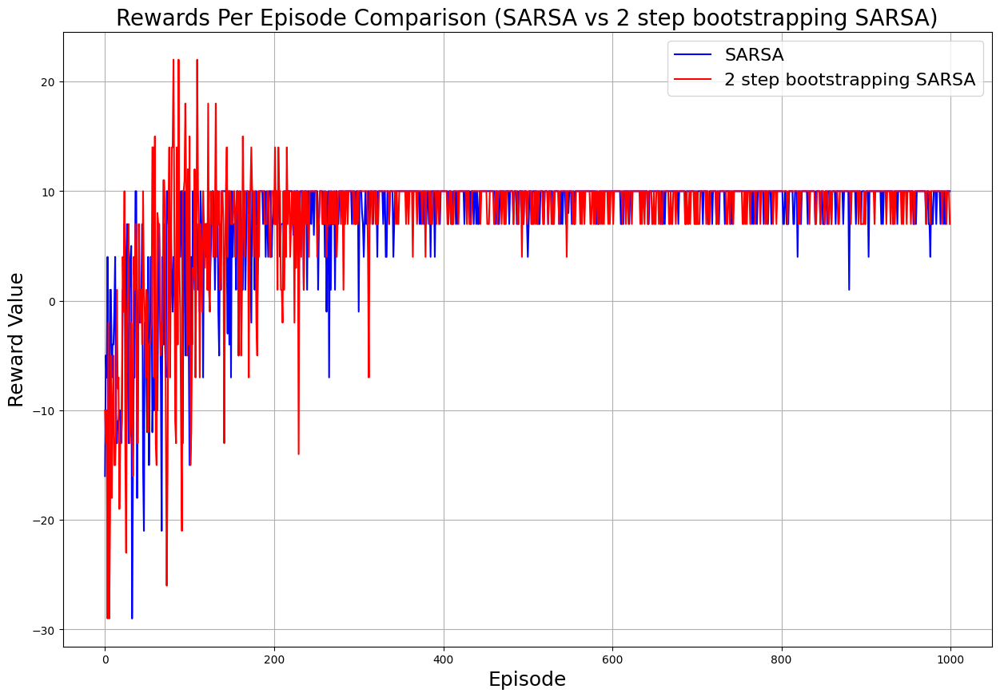

In [28]:
#comparison plot between the rewards obtained per episode for SARSA algorithm and two-step bootstrapping
plt.figure(figsize=(15, 10))

plt.plot(q_learning_rewards, color='blue', label='SARSA')

plt.plot(tot_rew_ns, color='red', label='2 step bootstrapping SARSA')

plt.xlabel('Episode', fontsize=18)
plt.ylabel('Reward Value', fontsize=18)
plt.title('Rewards Per Episode Comparison (SARSA vs 2 step bootstrapping SARSA)', fontsize=20)
plt.legend(fontsize=16)
plt.grid()
plt.show()

* It can be seen that the 2-step bootstrapping SARSA algorithm consistently outperforms the SARSA algorithm in the same environment.
* Throughout the episodes, the reward values for both algorithms fluctuate. However, the 2-step bootstrapping SARSA algorithm consistently achieves a higher reward value than the SARSA algorithm. This suggests that the 2-step bootstrapping SARSA algorithm is more effective in this particular environment.

Possible reasons that we can attribute to are:
1. Multi-step Updates: The 2-step bootstrapping SARSA uses a 2-step return for updating the Q-values, which means it considers the next two rewards instead of just the immediate reward. This can provide a more accurate estimate of the future rewards, especially in environments where the reward for an action is delayed.

2. Exploration vs Exploitation Trade-off: Both SARSA and 2-step bootstrapping SARSA are on-policy algorithms, but the multi-step update could affect the exploration-exploitation trade-off. The 2-step bootstrapping SARSA might be doing a better job of balancing exploration and exploitation in our specific environment.